# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [10]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [13]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda:0'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])
import os
print(os.getcwd())
dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

/home/amichay/DL/Courses/GANs-specialization-deeplearning.ai/1 - Build Basic Generative Adversarial Networks/Week 3


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


/home/amichay/.local/lib/python3.8/site-packages/torchvision/datasets/mnist.py:469: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, critic, and optimizers.

In [14]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [15]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [16]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [48]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [49]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [50]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1 * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [51]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)),
    torch.tensor(-1.0)
)
print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [54]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + (c_lambda * gp)
    #### END CODE HERE ####
    return crit_loss

In [55]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](https://drive.google.com/uc?id=1Tct8CPqVM5nUrHvA864ntv76XHZKqKUK&export=view)

Step 50: Generator loss: -0.11711236434523016, critic loss: 1.5403579666614535


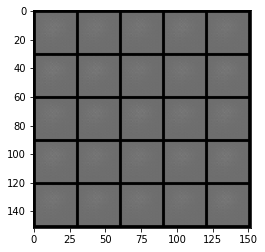

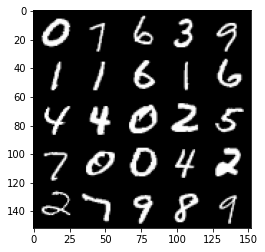

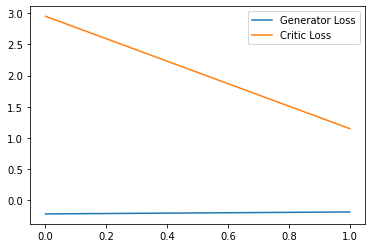

Step 100: Generator loss: 2.0529209458827973, critic loss: -4.059133422613145


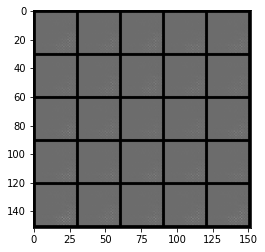

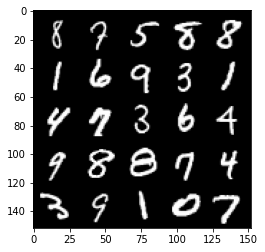

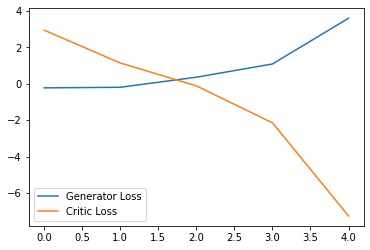

Step 150: Generator loss: 2.0183365631103514, critic loss: -16.131967020034786


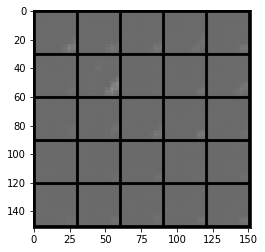

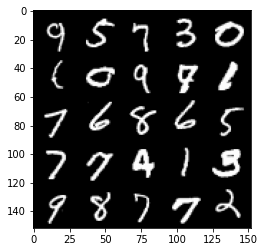

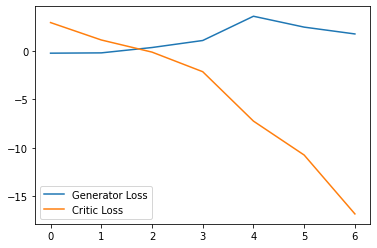

Step 200: Generator loss: -2.1270117960870265, critic loss: -37.81832652282715


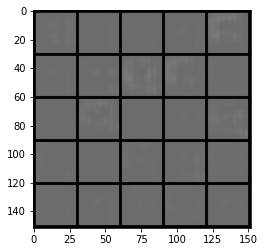

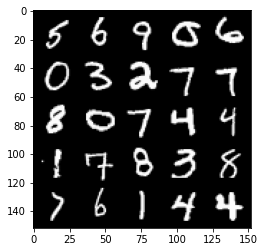

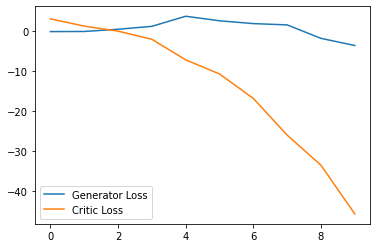

Step 250: Generator loss: -4.160805807113648, critic loss: -73.29900399780271


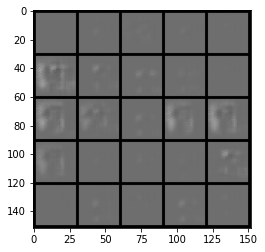

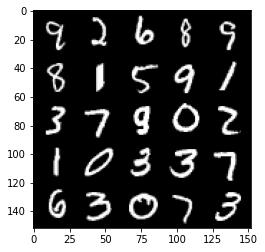

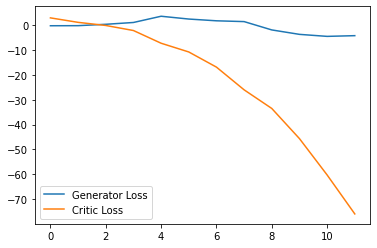

Step 300: Generator loss: -1.4317317140102386, critic loss: -120.8521311187744


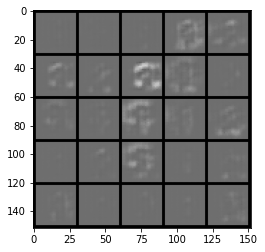

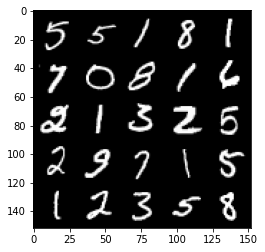

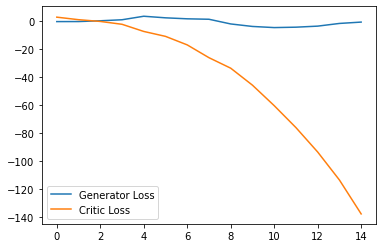

Step 350: Generator loss: 1.5594056084752084, critic loss: -175.59702243041994


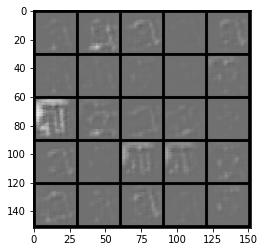

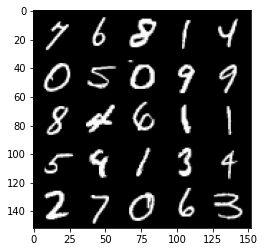

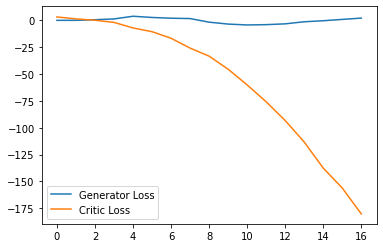

Step 400: Generator loss: 7.700108528137207, critic loss: -242.5802706909179


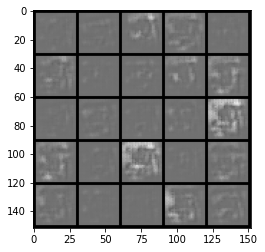

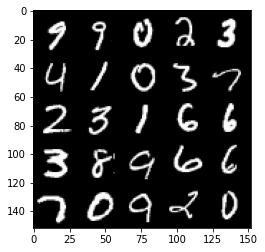

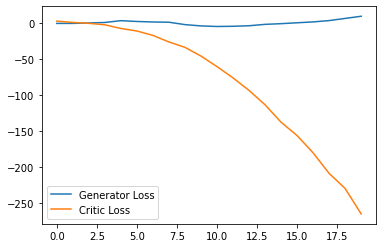

Step 450: Generator loss: 11.782505192756652, critic loss: -306.6061386108399


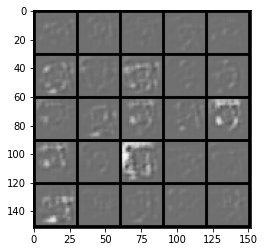

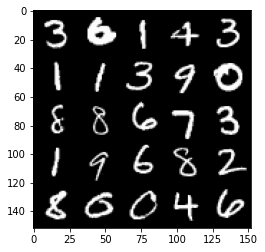

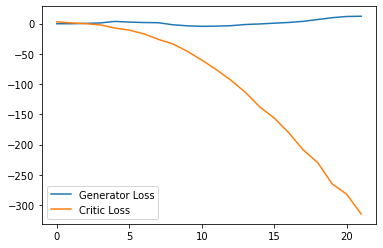

Step 500: Generator loss: 4.397320213913917, critic loss: -313.8066401672363


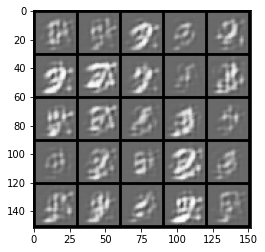

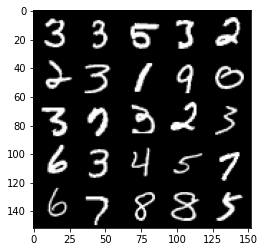

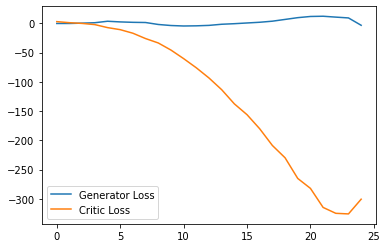

Step 550: Generator loss: -1.9412406635284425, critic loss: -291.43924645996094


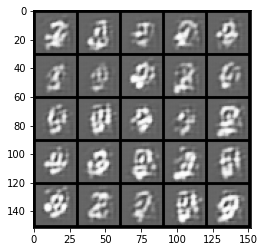

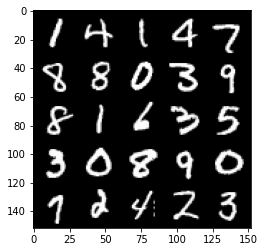

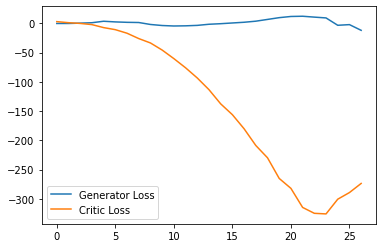

Step 600: Generator loss: 16.459034061431886, critic loss: -383.6864266967773


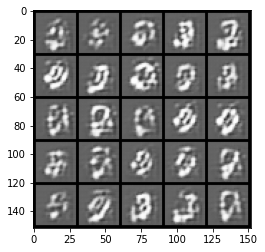

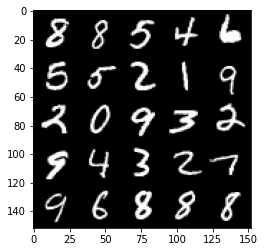

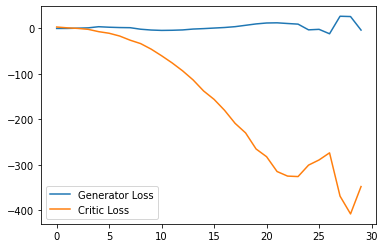

Step 650: Generator loss: -2.577166553735733, critic loss: -343.6775175781249


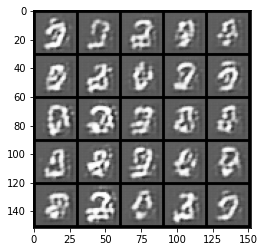

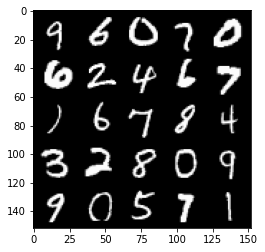

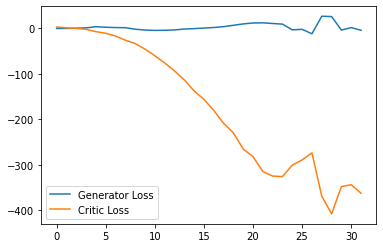

Step 700: Generator loss: -3.8224457120895385, critic loss: -351.88192523193374


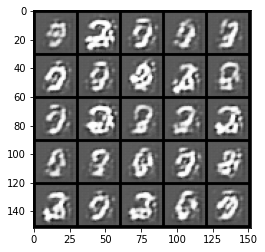

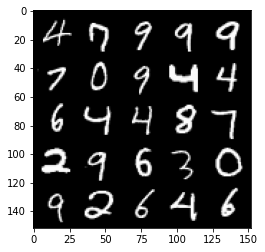

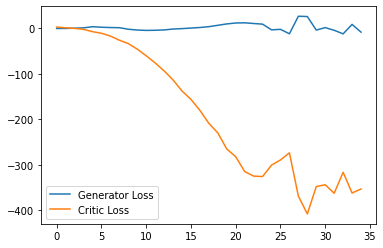

Step 750: Generator loss: -0.8341325330734253, critic loss: -347.56028448486325


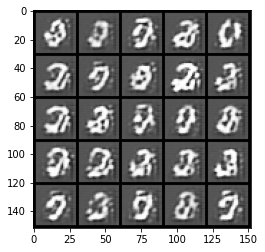

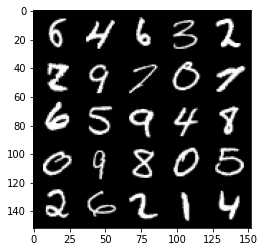

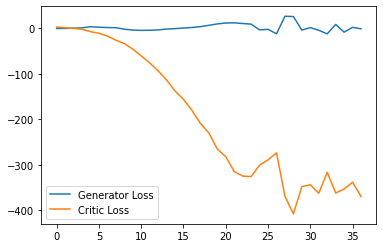

Step 800: Generator loss: -4.1976438456773755, critic loss: -372.7543464355469


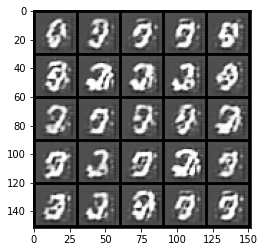

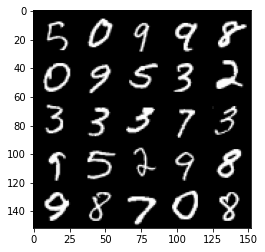

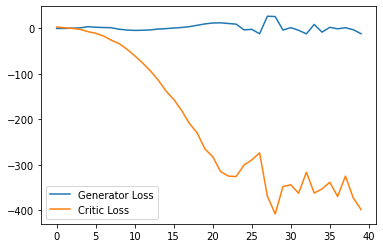

Step 850: Generator loss: -8.146002638339997, critic loss: -354.2655612792967


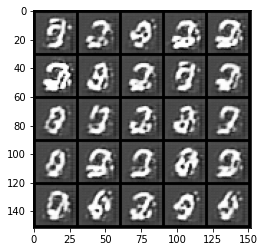

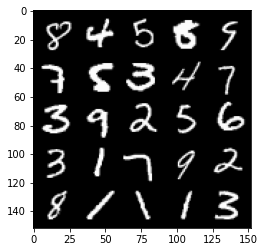

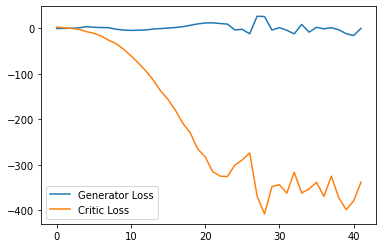

Step 900: Generator loss: -37.80916173934936, critic loss: -323.7198524169923


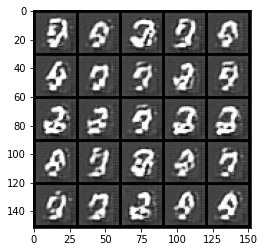

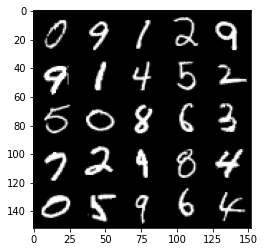

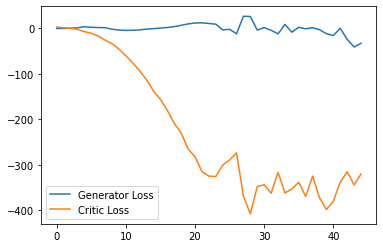

Step 950: Generator loss: -2.6568967239558696, critic loss: -61.57611917877196


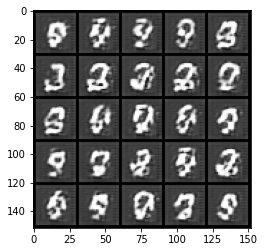

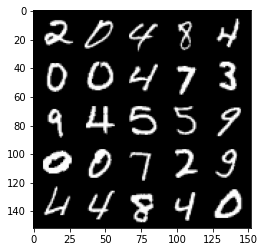

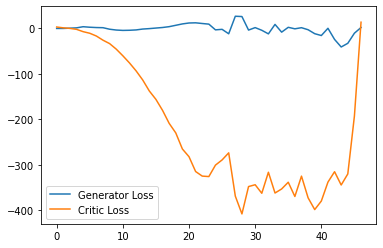

Step 1000: Generator loss: -1.6743379071354867, critic loss: 0.3081947021484378


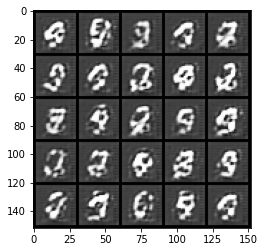

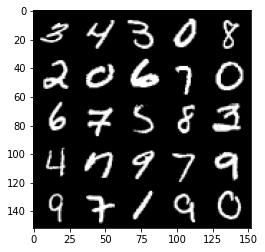

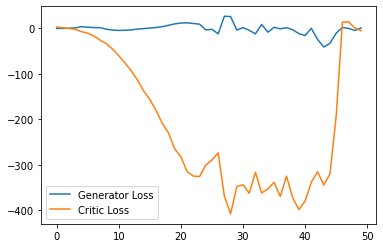

Step 1050: Generator loss: 3.9860052716732026, critic loss: -26.962896278381344


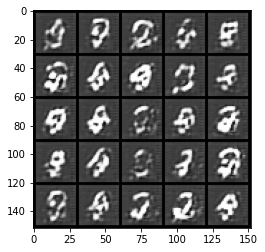

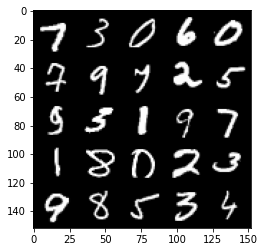

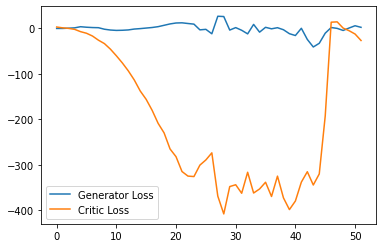

Step 1100: Generator loss: -5.690638961791993, critic loss: -135.56635943603519


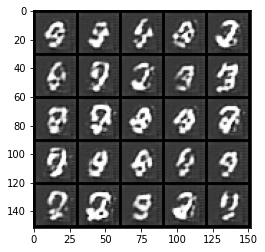

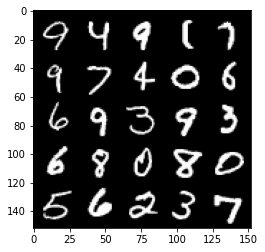

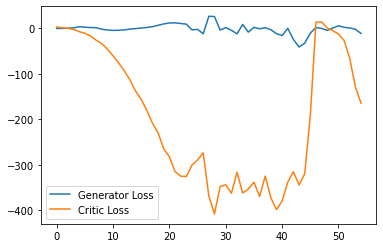

Step 1150: Generator loss: 6.262384426593781, critic loss: -134.94261196899413


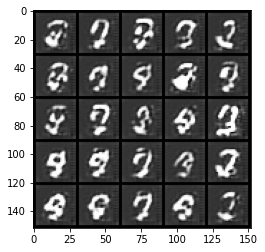

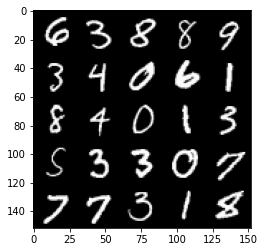

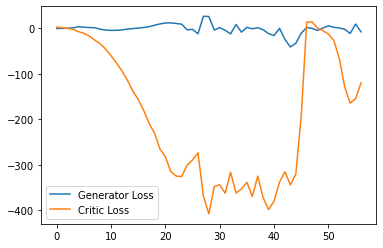

Step 1200: Generator loss: 10.073147677183151, critic loss: -76.04434814453126


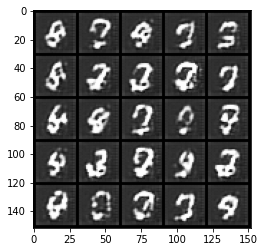

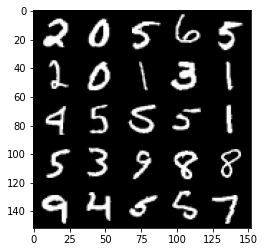

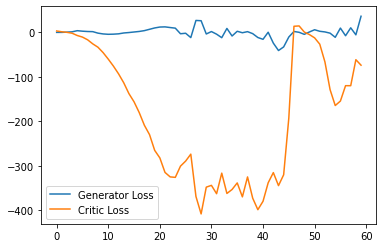

Step 1250: Generator loss: -18.356640973091125, critic loss: -74.09102540588377


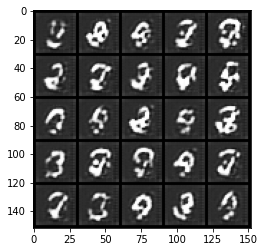

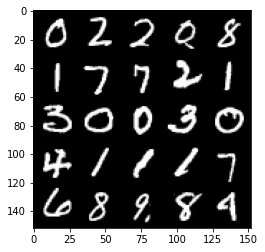

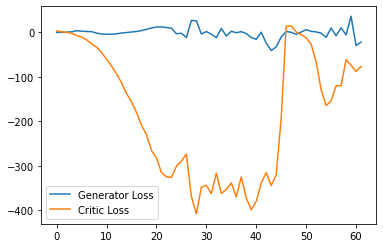

Step 1300: Generator loss: -17.55322203159332, critic loss: -34.467151580810544


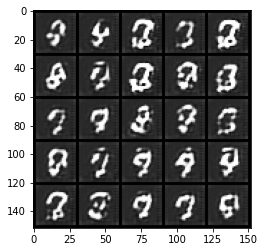

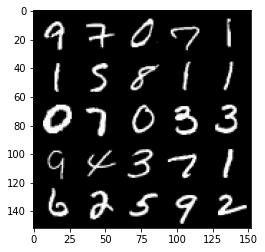

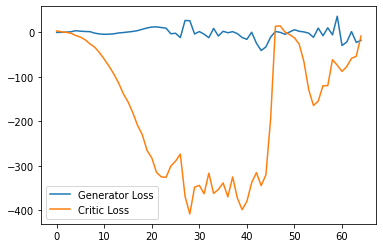

Step 1350: Generator loss: -4.6803341126441955, critic loss: -4.19868566894531


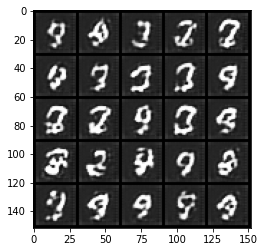

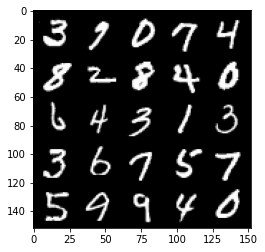

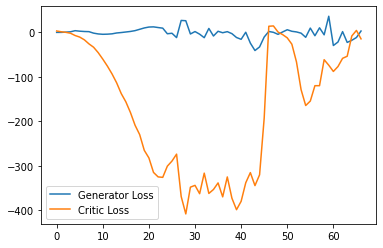

Step 1400: Generator loss: 12.869079418182373, critic loss: 44.28410678100587


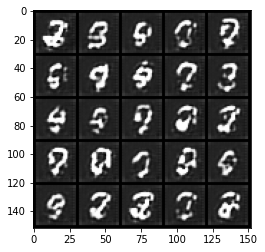

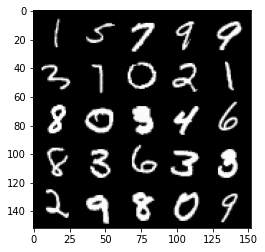

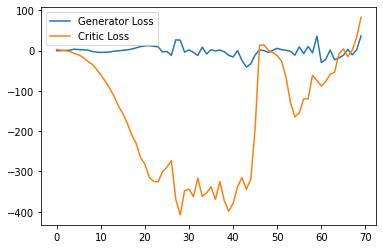

Step 1450: Generator loss: 35.15420280456543, critic loss: 52.022134231567385


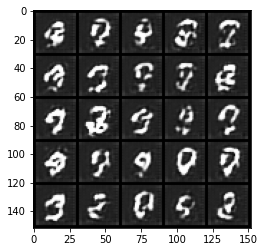

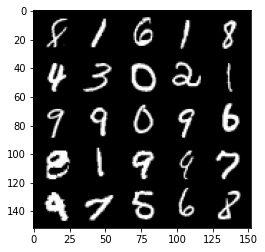

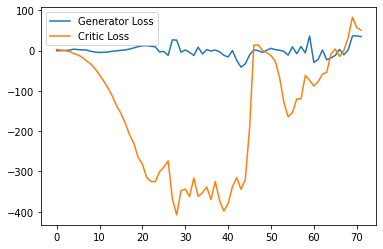

Step 1500: Generator loss: 31.906361274719238, critic loss: 44.256229949951184


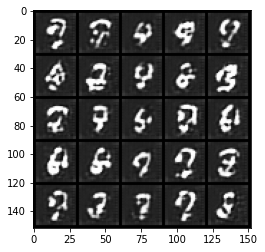

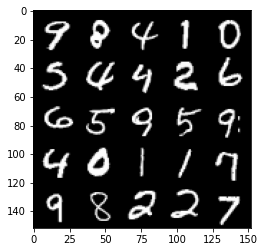

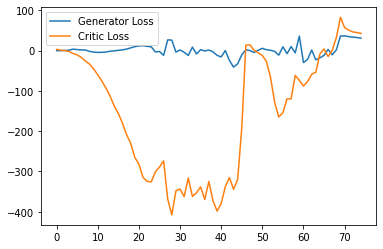

Step 1550: Generator loss: 28.7096533203125, critic loss: 43.29468026733398


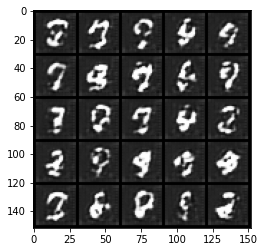

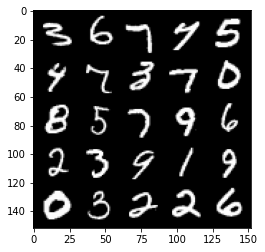

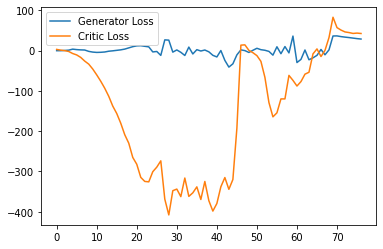

Step 1600: Generator loss: 25.072076034545898, critic loss: 44.79871144104004


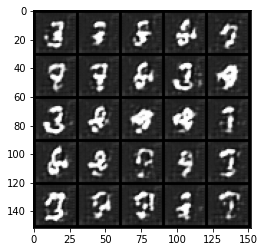

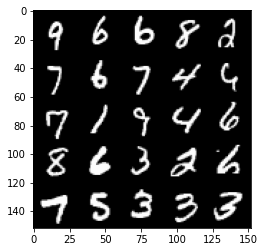

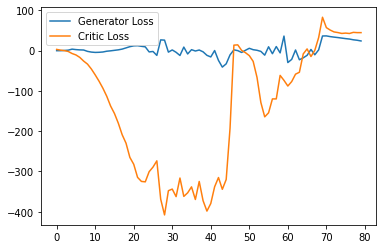

Step 1650: Generator loss: 21.688761711120605, critic loss: 38.62662588500977


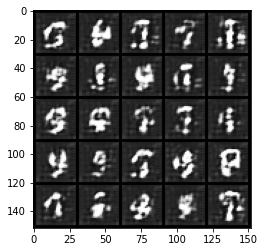

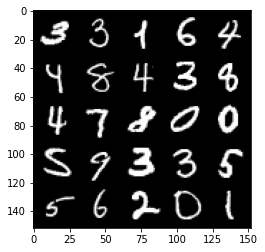

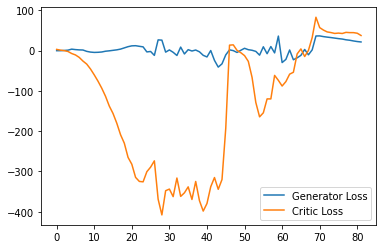

Step 1700: Generator loss: 20.1006143951416, critic loss: 31.115110023498552


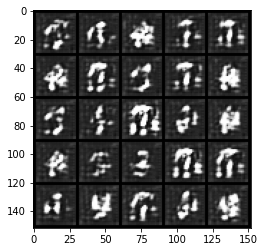

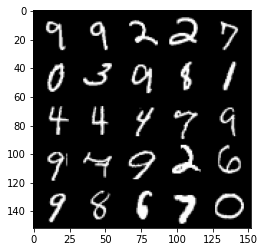

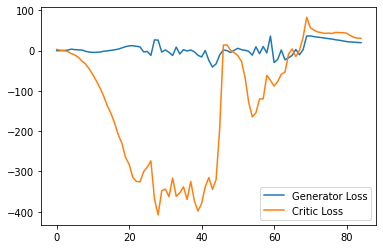

Step 1750: Generator loss: 17.739916248321535, critic loss: 28.799878570556643


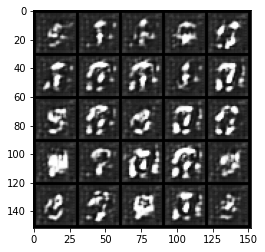

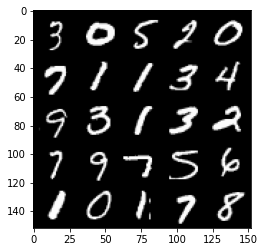

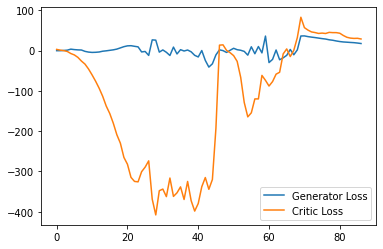

Step 1800: Generator loss: 14.688898544311524, critic loss: 21.84539402770996


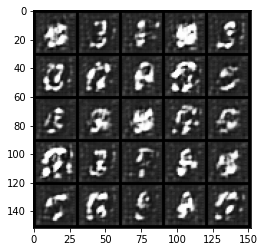

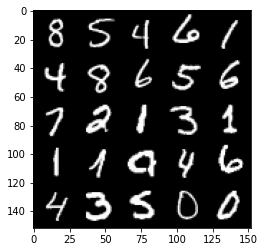

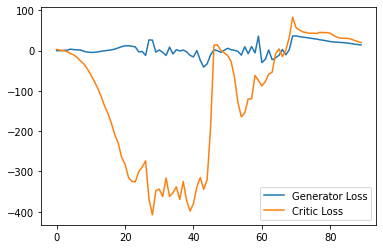

Step 1850: Generator loss: 12.664763221740722, critic loss: 15.945204547882078


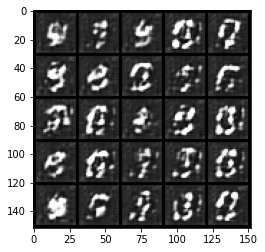

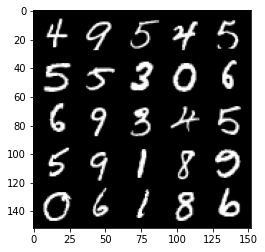

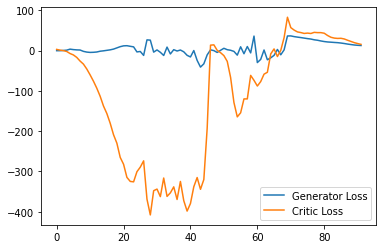

Step 1900: Generator loss: 11.755600185394288, critic loss: 12.770269374847413


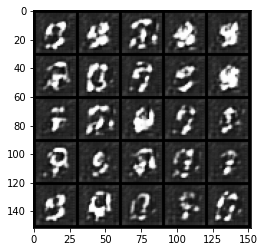

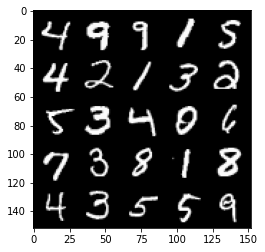

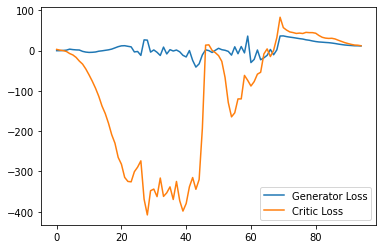

Step 1950: Generator loss: 11.571095905303956, critic loss: 9.210048011779785


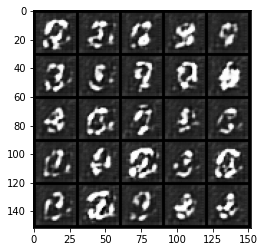

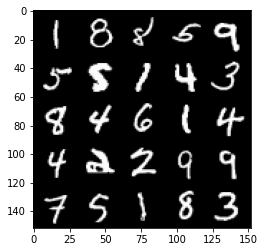

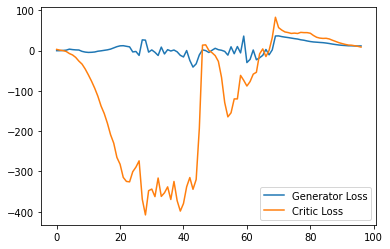

Step 2000: Generator loss: 11.89264970779419, critic loss: 5.992664903640747


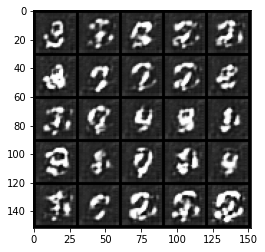

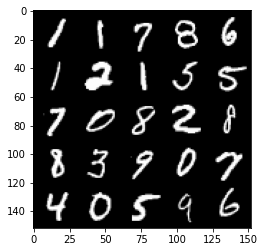

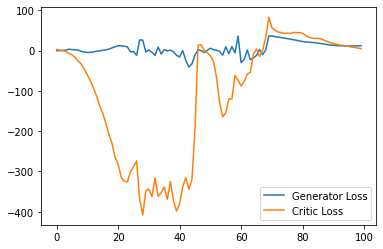

Step 2050: Generator loss: 11.284732303619386, critic loss: 3.2199414043426526


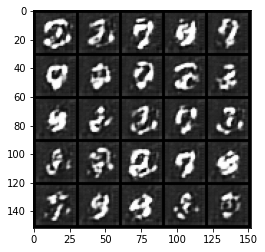

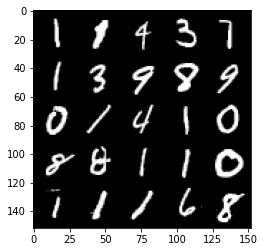

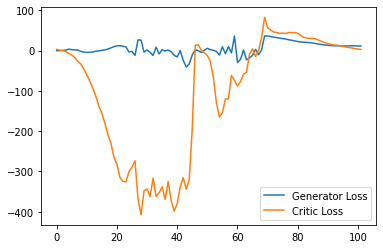

Step 2100: Generator loss: 12.296687698364257, critic loss: 1.0072118530273435


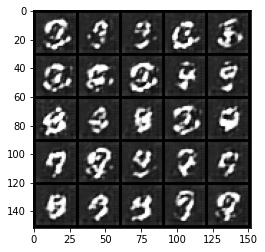

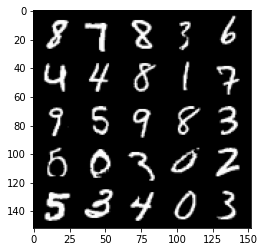

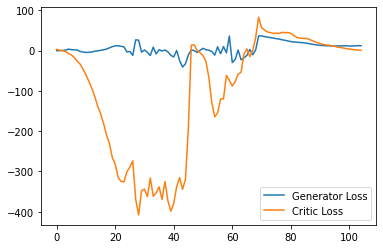

Step 2150: Generator loss: 13.42828151702881, critic loss: -1.3073044643402099


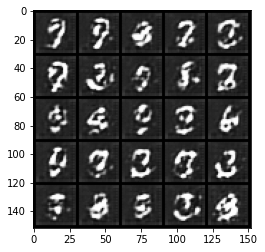

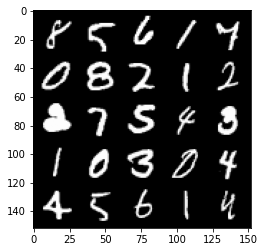

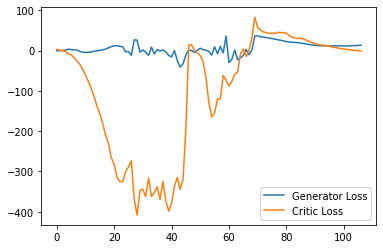

Step 2200: Generator loss: 13.647815551757812, critic loss: -2.7063728446960447


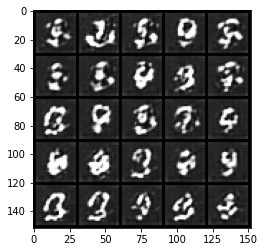

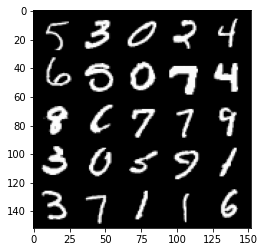

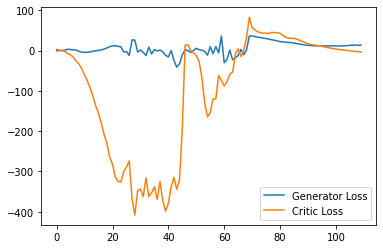

Step 2250: Generator loss: 14.855232887268066, critic loss: -4.901939628601074


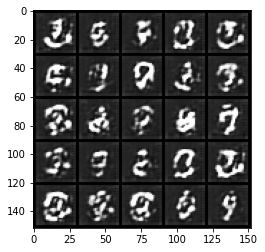

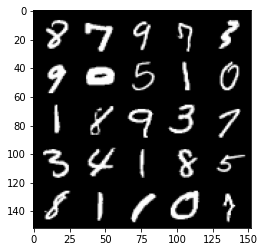

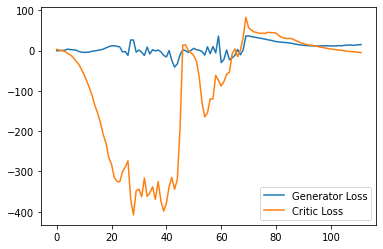

Step 2300: Generator loss: 15.444816646575928, critic loss: -6.225159856796265


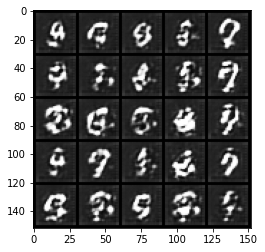

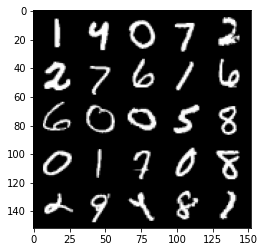

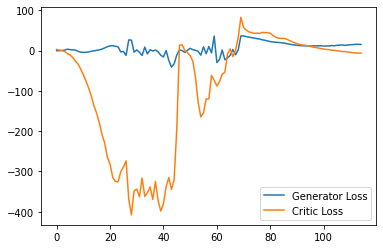

Step 2350: Generator loss: 16.80434947967529, critic loss: -8.613808876037599


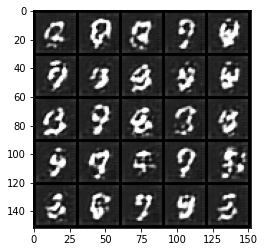

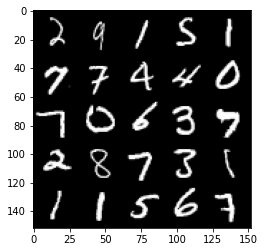

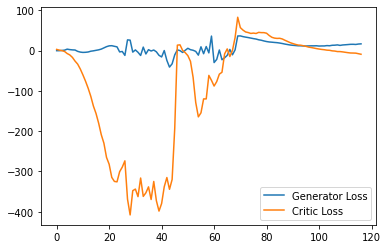

Step 2400: Generator loss: 16.34278741836548, critic loss: -10.251725885391233


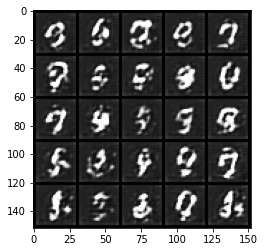

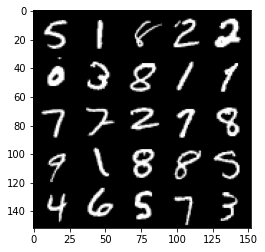

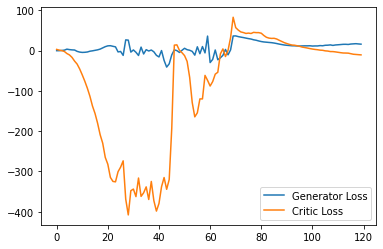

Step 2450: Generator loss: 17.152649536132813, critic loss: -11.210231155395512


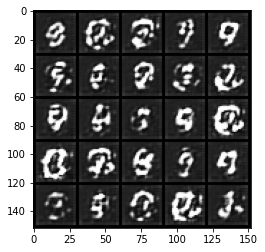

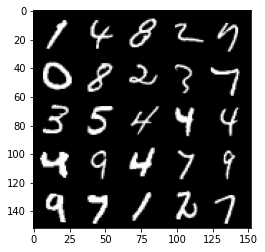

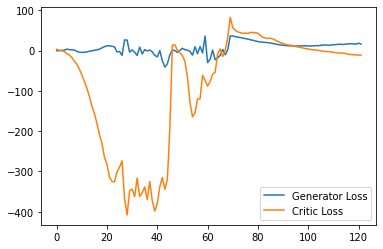

Step 2500: Generator loss: 19.078111848831178, critic loss: -12.505563785552974


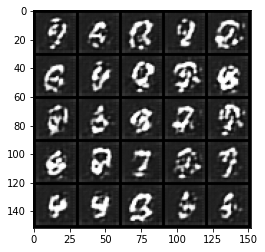

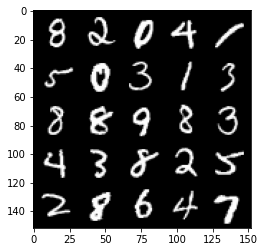

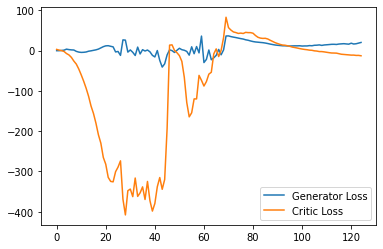

Step 2550: Generator loss: 19.83541160583496, critic loss: -12.910429634094237


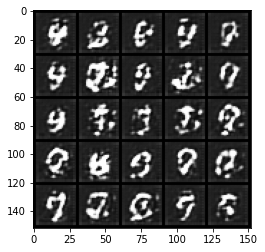

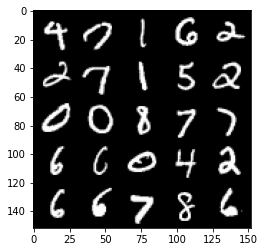

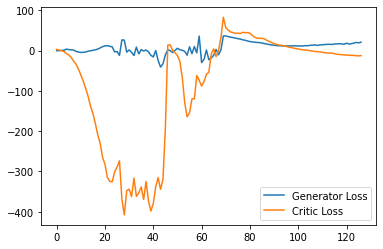

Step 2600: Generator loss: 21.63885467529297, critic loss: -13.603763330459604


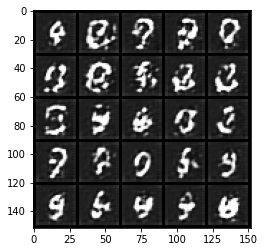

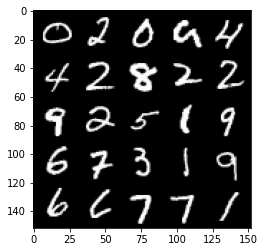

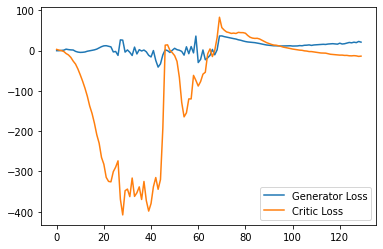

Step 2650: Generator loss: 22.301677055358887, critic loss: -14.178691425323484


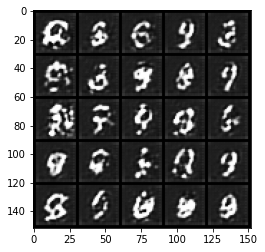

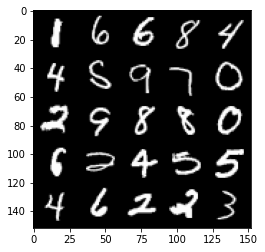

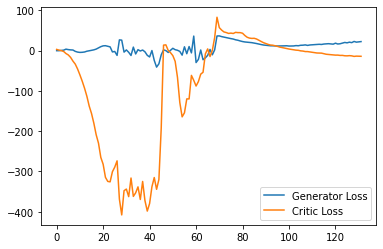

Step 2700: Generator loss: 23.17110233306885, critic loss: -14.841674211502072


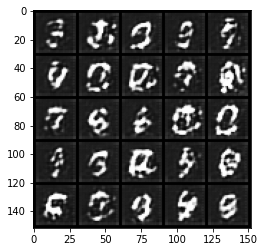

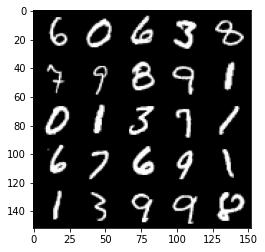

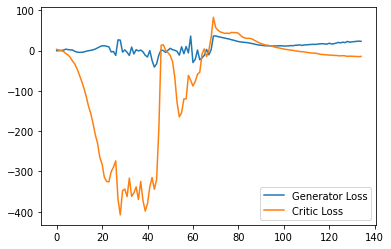

Step 2750: Generator loss: 23.526766185760497, critic loss: -14.504662755966187


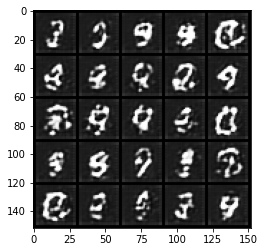

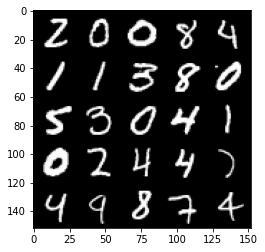

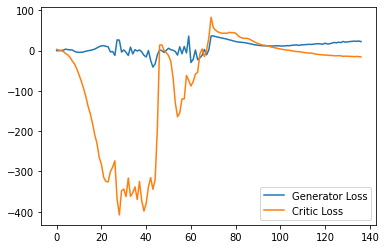

Step 2800: Generator loss: 24.948972969055177, critic loss: -14.6092239818573


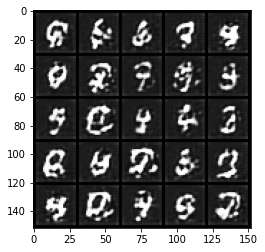

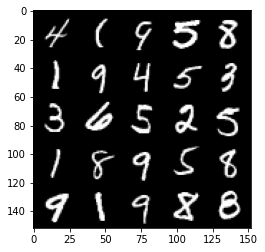

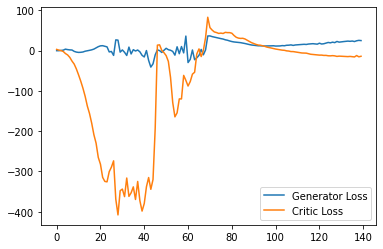

Step 2850: Generator loss: 26.583910217285155, critic loss: -15.26409145545959


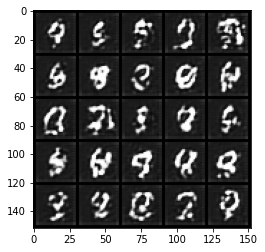

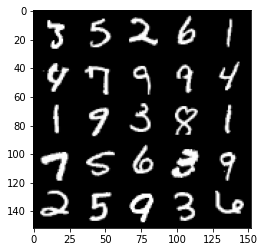

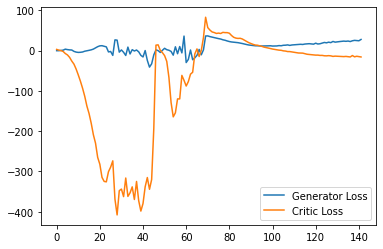

Step 2900: Generator loss: 28.123591117858886, critic loss: -15.161701555252073


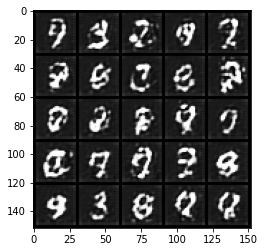

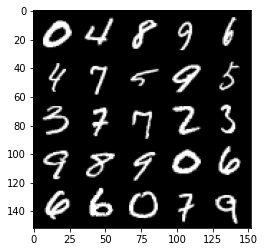

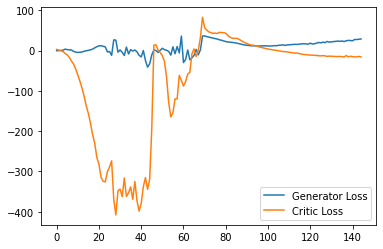

Step 2950: Generator loss: 28.688254890441893, critic loss: -15.147633430480958


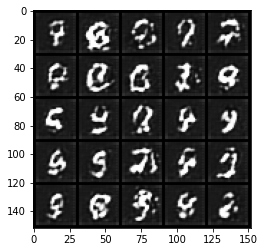

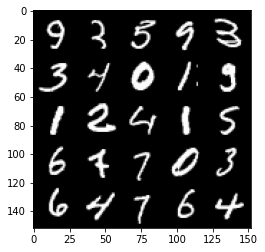

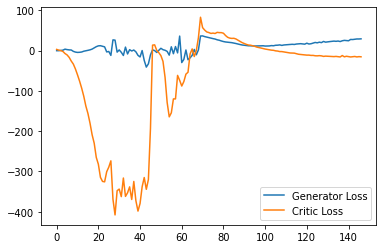

Step 3000: Generator loss: 31.21397579193115, critic loss: -15.498933801651


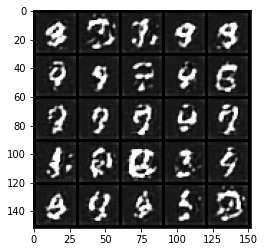

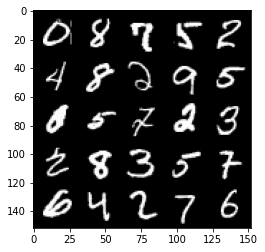

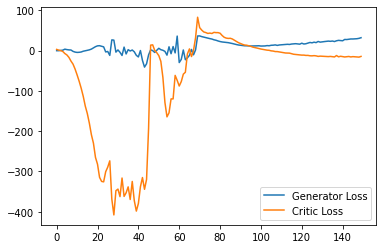

Step 3050: Generator loss: 29.593581161499024, critic loss: -15.445288278579715


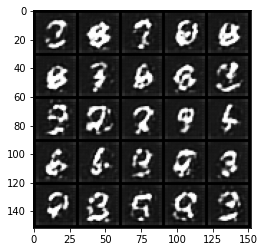

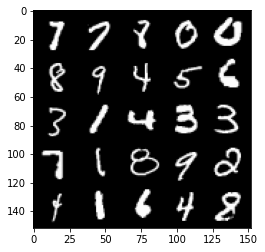

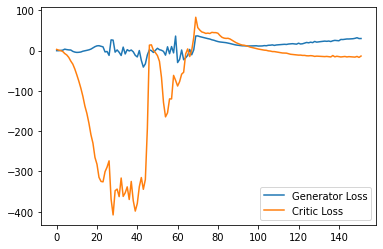

Step 3100: Generator loss: 31.534022331237793, critic loss: -15.785730213165284


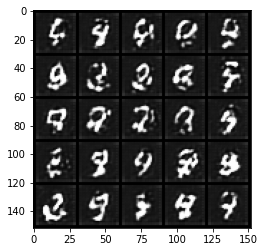

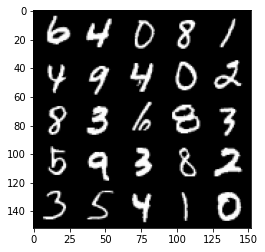

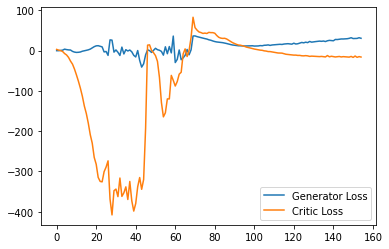

Step 3150: Generator loss: 31.808371543884277, critic loss: -15.249154381752016


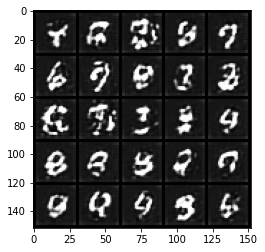

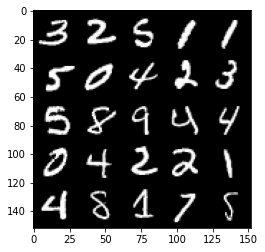

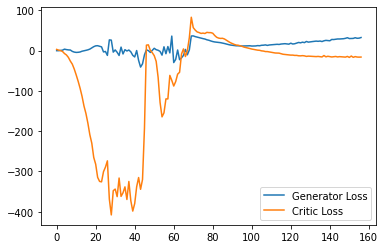

Step 3200: Generator loss: 33.409589004516604, critic loss: -16.08168737030029


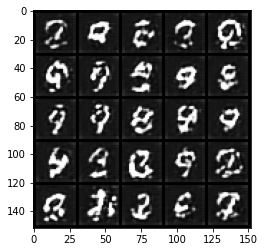

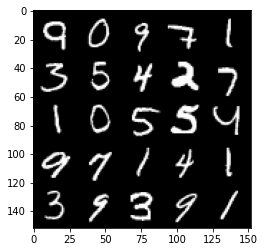

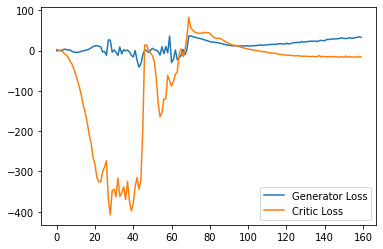

Step 3250: Generator loss: 31.854392700195312, critic loss: -13.23186190319061


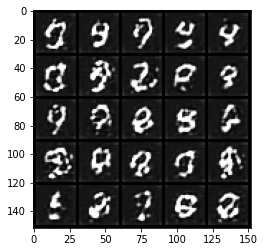

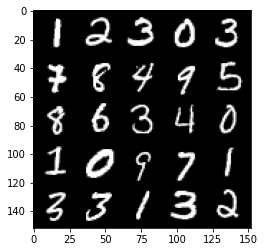

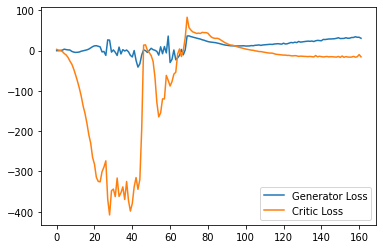

Step 3300: Generator loss: 32.83757373809814, critic loss: -12.162254190444946


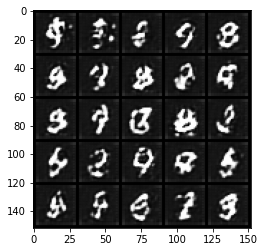

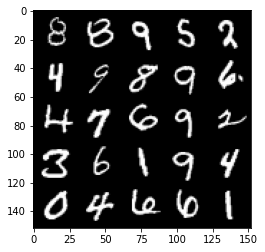

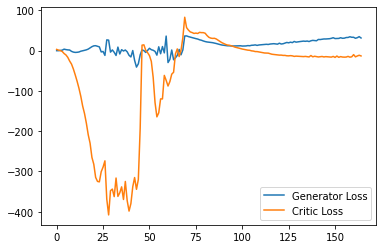

Step 3350: Generator loss: 35.15236000061035, critic loss: -9.366482074737549


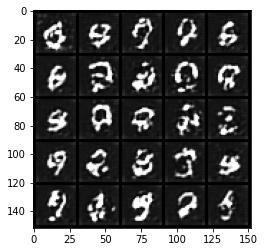

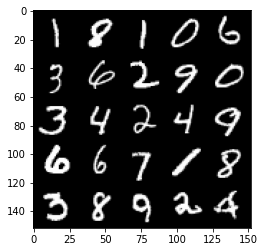

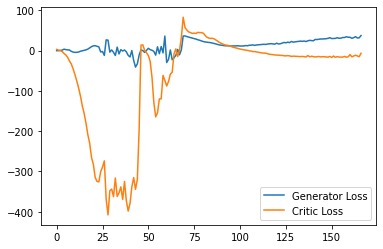

Step 3400: Generator loss: 32.216527709960936, critic loss: -13.955602451324461


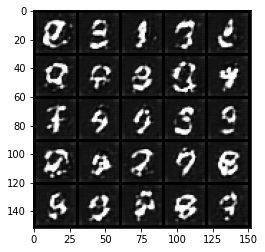

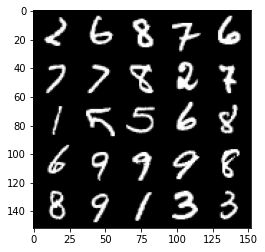

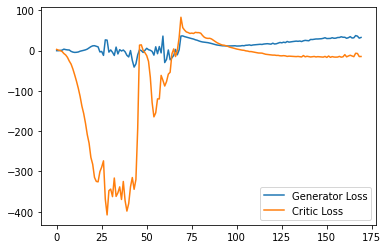

Step 3450: Generator loss: 32.80134181976318, critic loss: -14.330825186729431


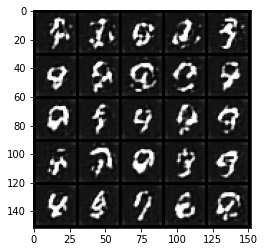

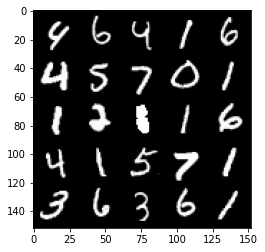

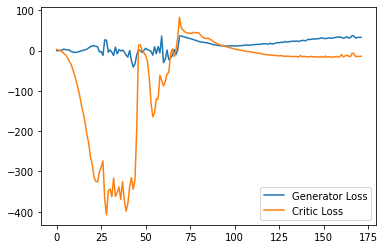

Step 3500: Generator loss: 32.55412200927734, critic loss: -13.78192015457153


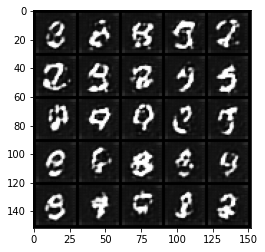

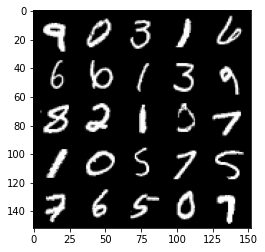

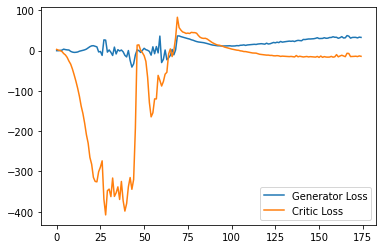

Step 3550: Generator loss: 33.22605163574219, critic loss: -13.312760676383974


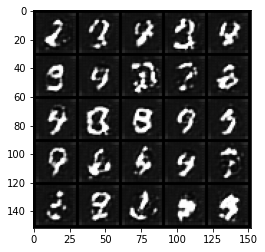

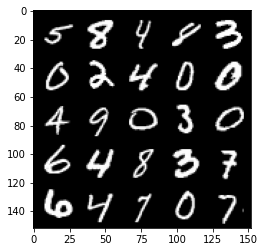

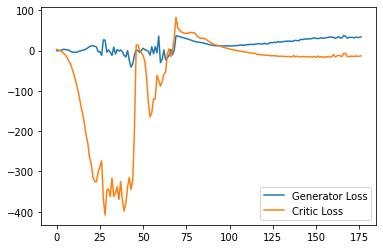

Step 3600: Generator loss: 32.02505500793457, critic loss: -13.598604320526118


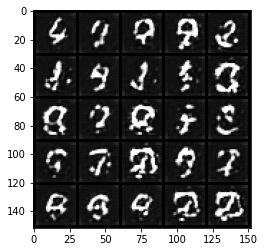

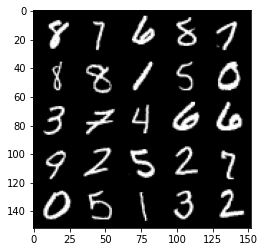

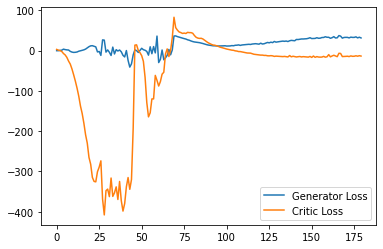

Step 3650: Generator loss: 31.830137367248536, critic loss: -12.381834185600278


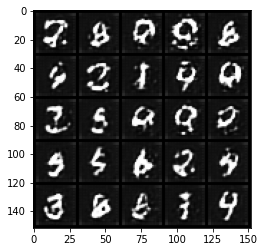

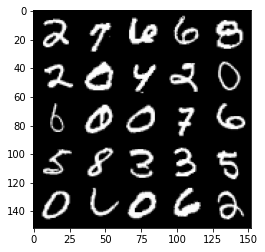

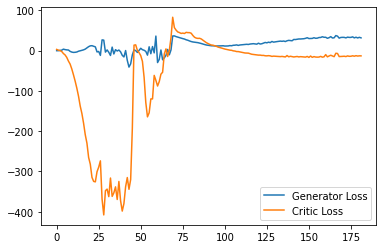

Step 3700: Generator loss: 33.34043216705322, critic loss: -9.972184688568115


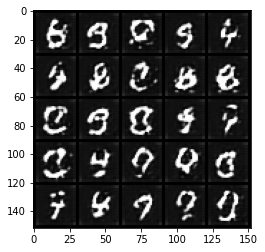

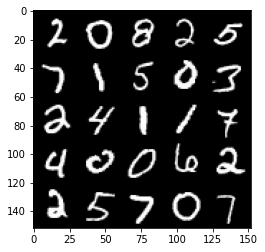

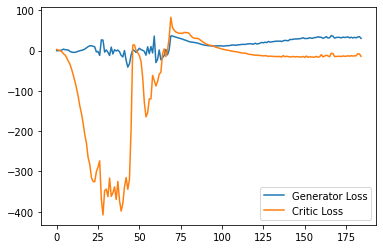

Step 3750: Generator loss: 32.549369468688965, critic loss: -12.19363906669617


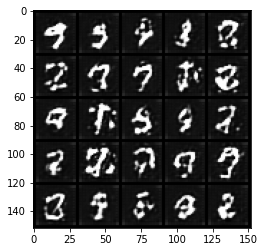

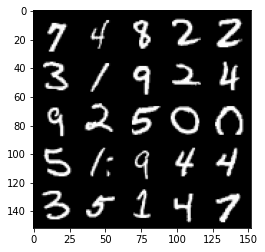

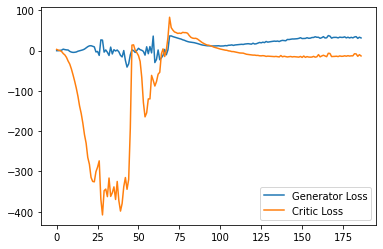

Step 3800: Generator loss: 31.15554454803467, critic loss: -13.17439519691467


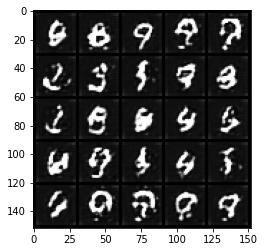

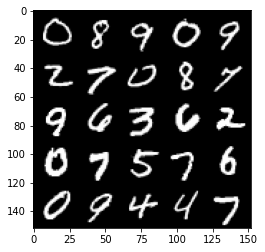

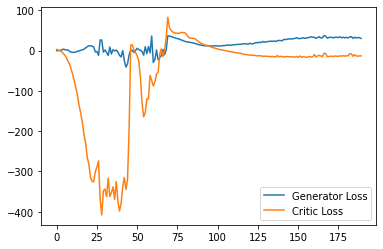

Step 3850: Generator loss: 31.32791217803955, critic loss: -12.494261364936829


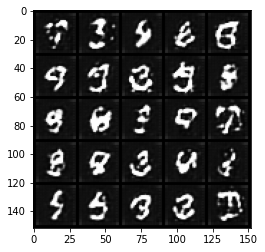

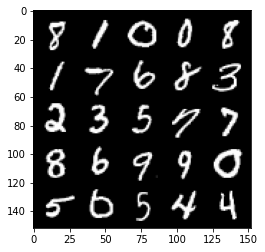

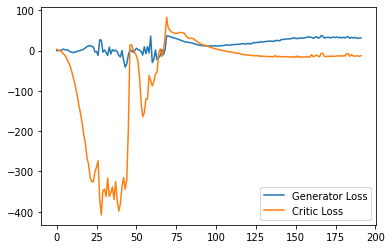

Step 3900: Generator loss: 29.947473182678223, critic loss: -12.006979342460626


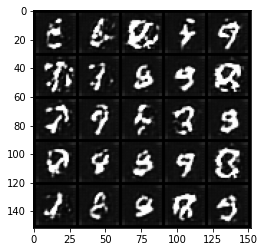

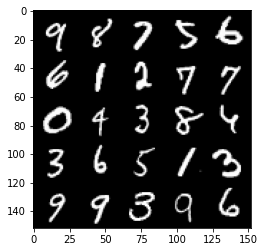

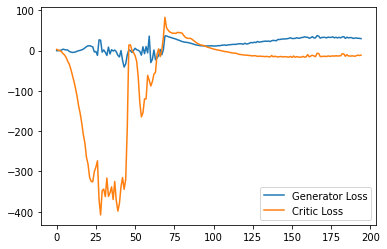

Step 3950: Generator loss: 30.29337631225586, critic loss: -10.824008603096008


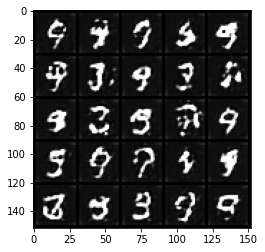

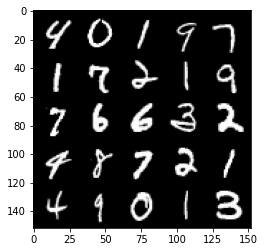

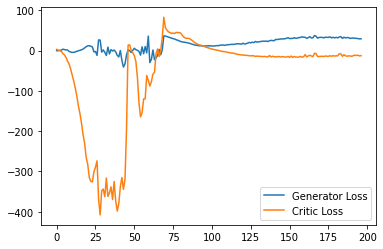

Step 4000: Generator loss: 29.17305850982666, critic loss: -11.039989780426025


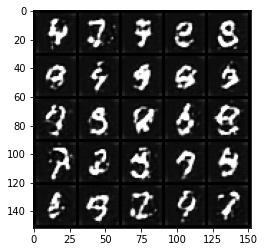

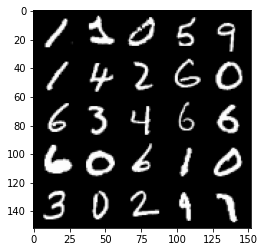

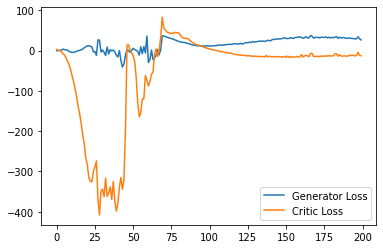

Step 4050: Generator loss: 29.71604362487793, critic loss: -8.068898873329163


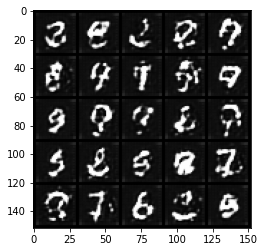

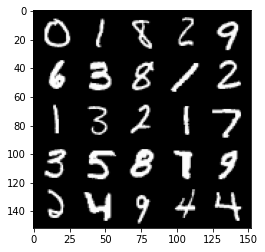

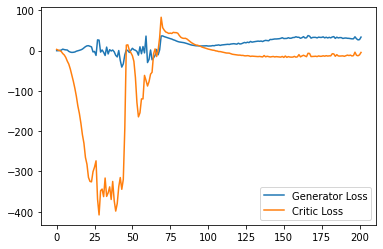

Step 4100: Generator loss: 29.06436550140381, critic loss: -8.477784756660462


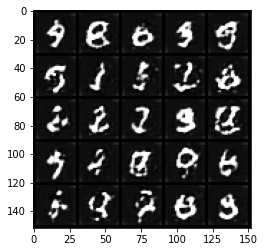

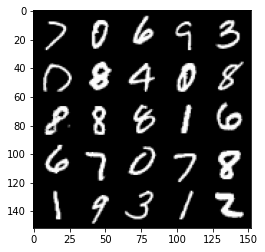

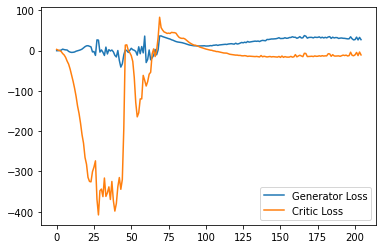

Step 4150: Generator loss: 26.2098770904541, critic loss: -13.010759419441221


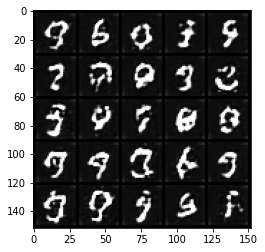

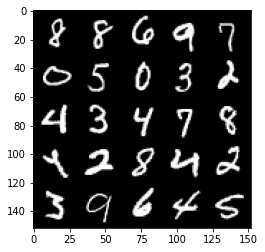

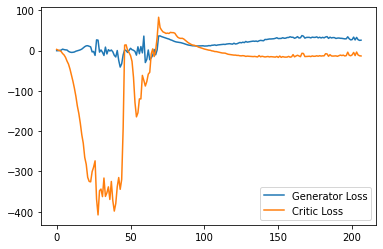

Step 4200: Generator loss: 27.019106998443604, critic loss: -12.4841358575821


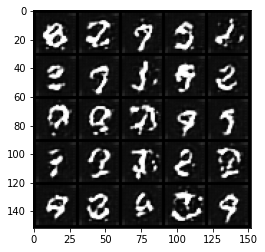

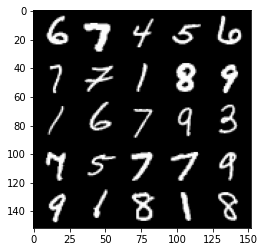

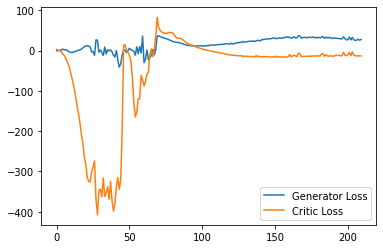

Step 4250: Generator loss: 28.85286003112793, critic loss: -10.147373065948486


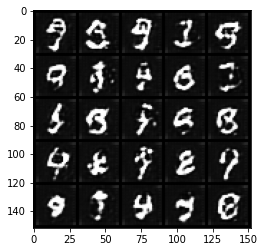

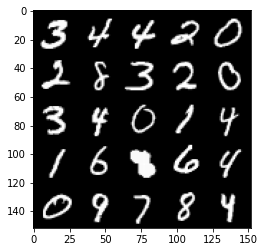

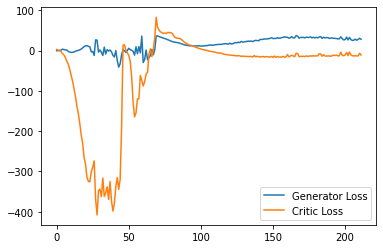

Step 4300: Generator loss: 27.467514686584472, critic loss: -11.263525539398195


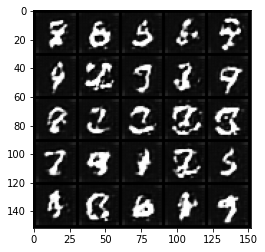

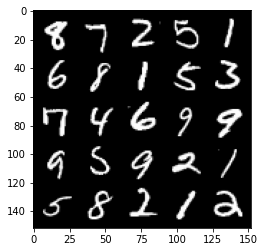

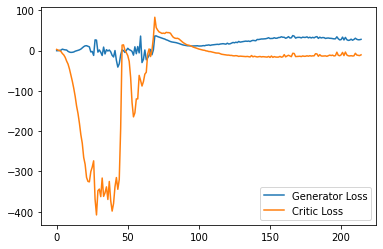

Step 4350: Generator loss: 26.52242702484131, critic loss: -12.40887862586975


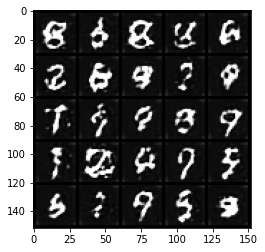

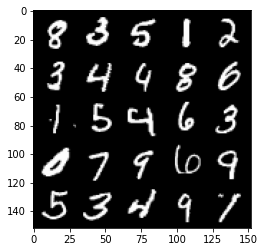

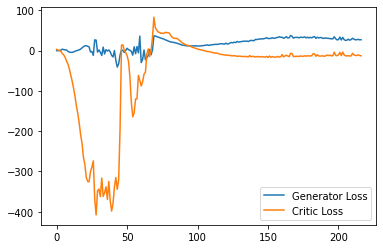

Step 4400: Generator loss: 27.558310279846193, critic loss: -7.072094611644743


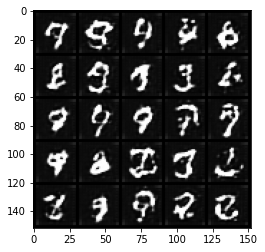

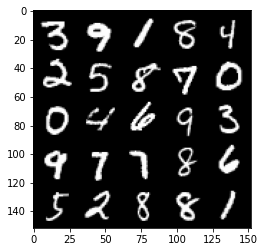

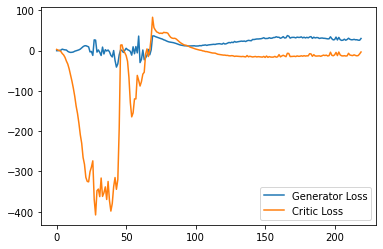

Step 4450: Generator loss: 27.086161613464355, critic loss: -9.836619623184204


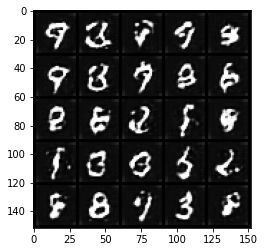

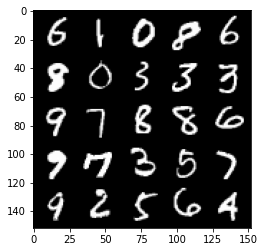

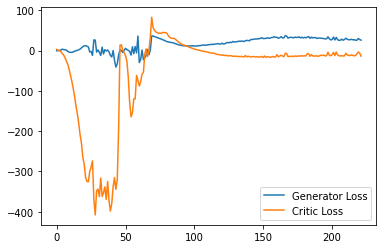

Step 4500: Generator loss: 27.001195945739745, critic loss: -12.593055588722228


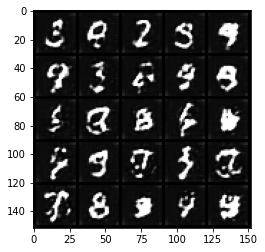

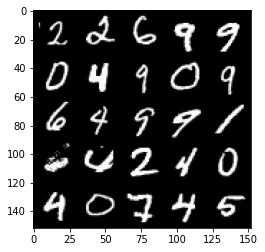

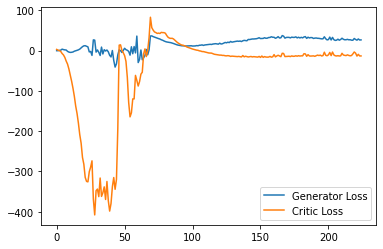

Step 4550: Generator loss: 27.097189445495605, critic loss: -13.51718095397949


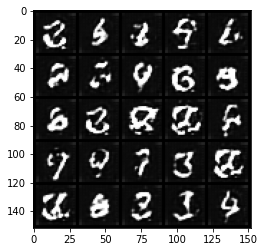

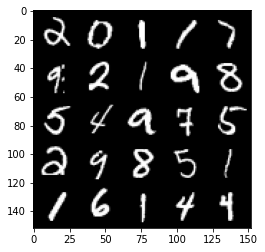

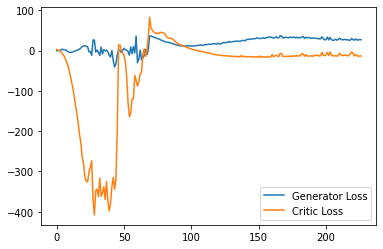

Step 4600: Generator loss: 30.5631164932251, critic loss: -6.038335820674896


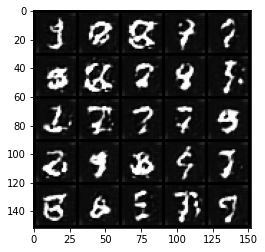

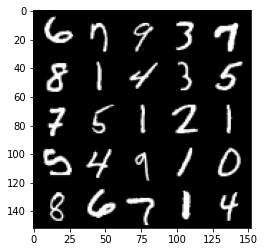

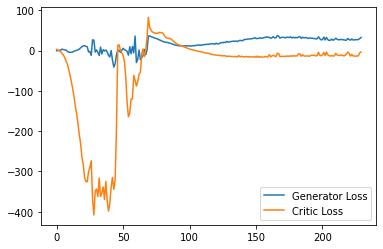

Step 4650: Generator loss: 28.865632934570314, critic loss: -7.342702186584473


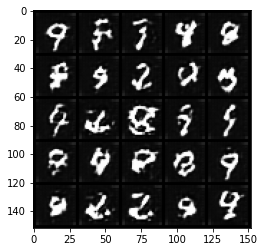

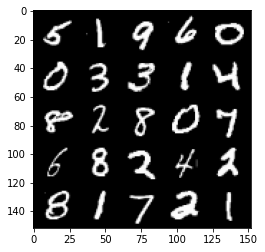

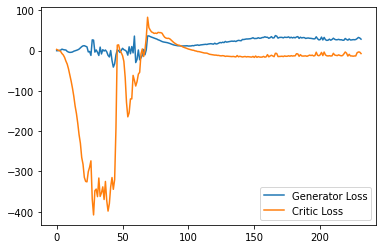

Step 4700: Generator loss: 26.939680099487305, critic loss: -13.29995048809052


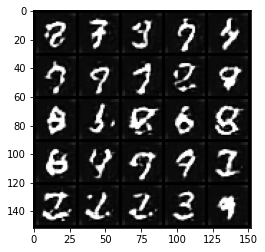

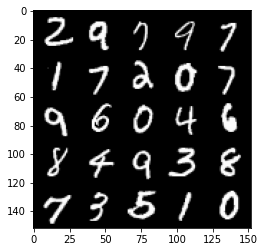

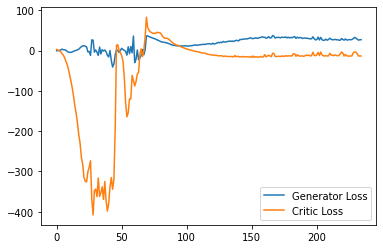

Step 4750: Generator loss: 28.4862805557251, critic loss: -13.88785705280304


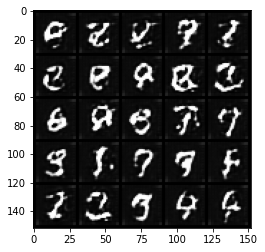

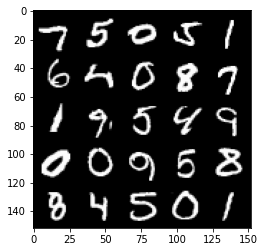

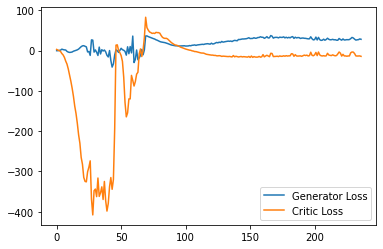

Step 4800: Generator loss: 29.512478828430176, critic loss: -12.037342099189761


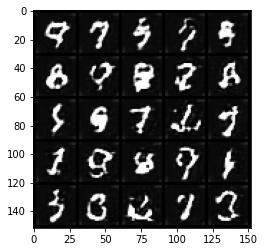

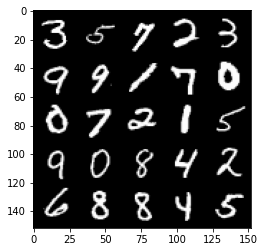

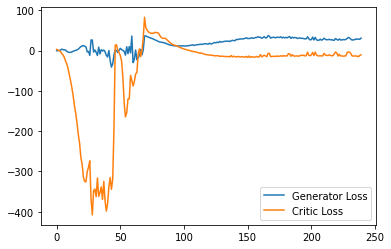

Step 4850: Generator loss: 30.380105018615723, critic loss: -10.034407406330107


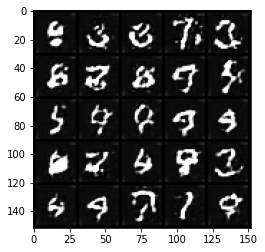

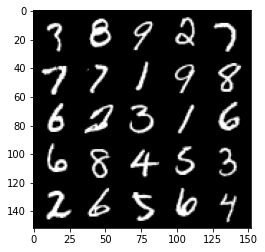

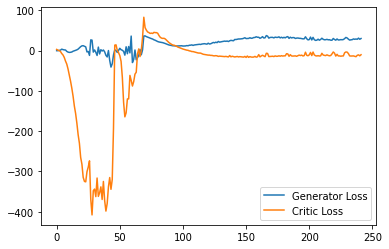

Step 4900: Generator loss: 29.288595542907714, critic loss: -11.311719251632688


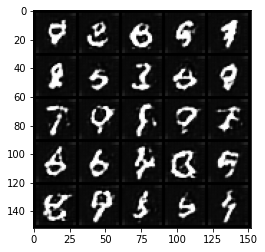

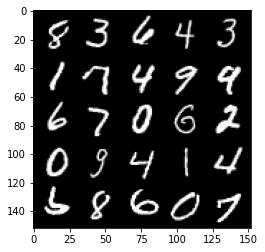

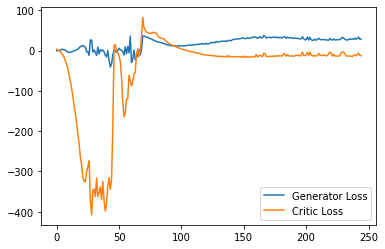

Step 4950: Generator loss: 30.180026473999025, critic loss: -12.995444372177126


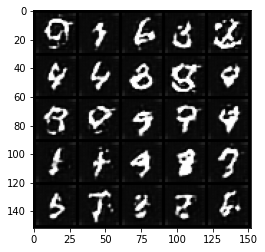

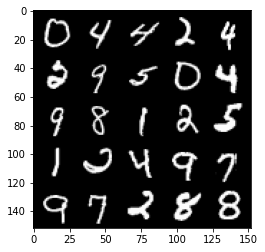

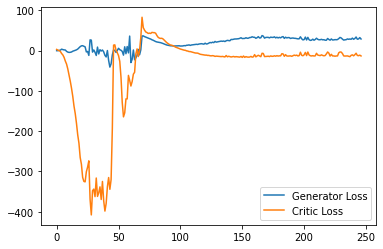

Step 5000: Generator loss: 30.25670795440674, critic loss: -13.985791988372805


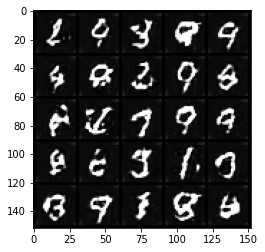

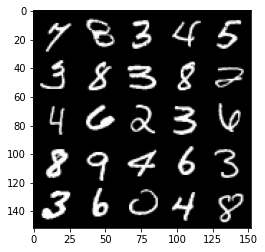

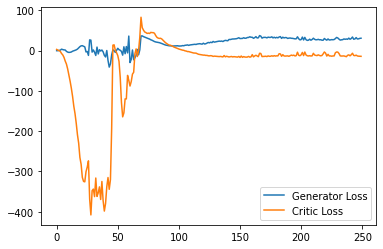

Step 5050: Generator loss: 32.13978523254394, critic loss: -12.961539700508121


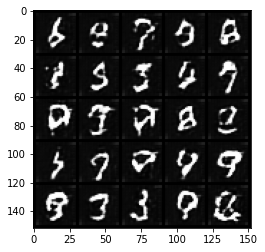

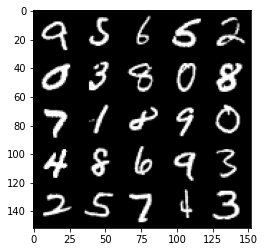

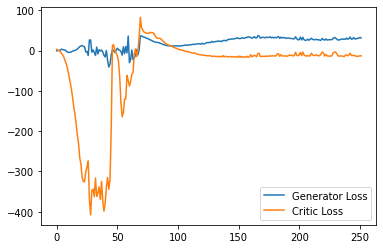

Step 5100: Generator loss: 30.381885681152344, critic loss: -13.11261165046692


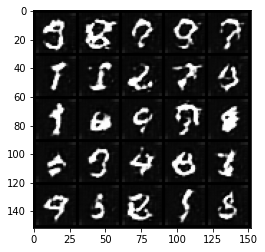

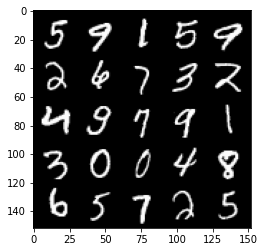

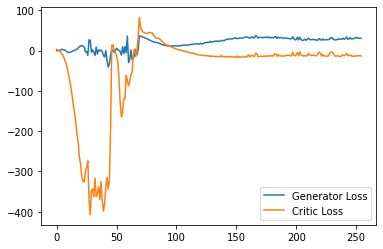

Step 5150: Generator loss: 31.28043384552002, critic loss: -9.571161787986753


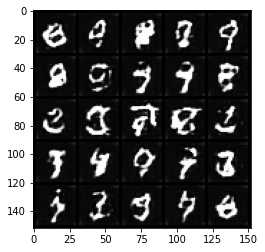

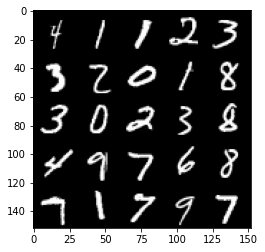

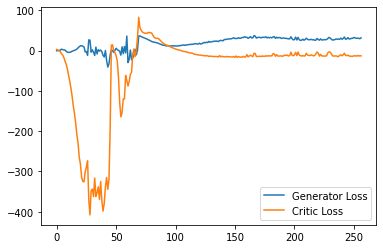

Step 5200: Generator loss: 30.592465286254882, critic loss: -12.492293562412264


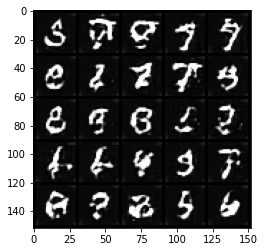

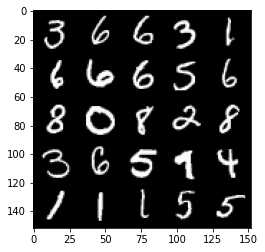

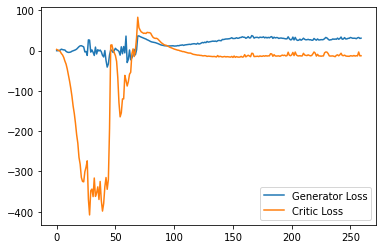

Step 5250: Generator loss: 30.979424171447754, critic loss: -14.171050387382504


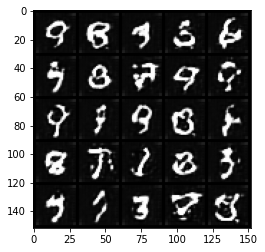

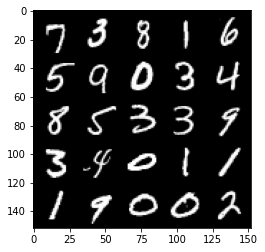

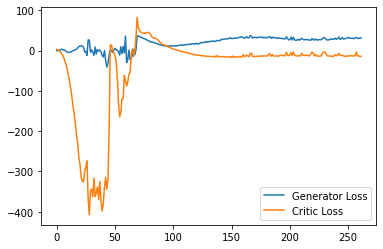

Step 5300: Generator loss: 32.160100059509276, critic loss: -13.813092125892636


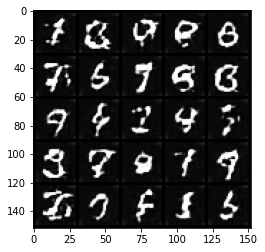

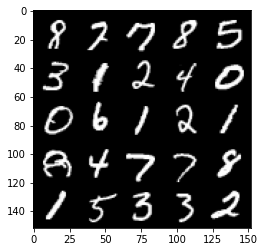

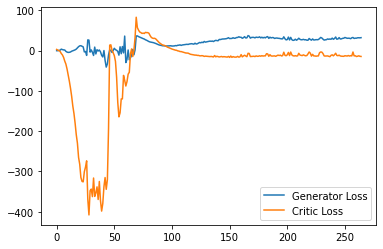

Step 5350: Generator loss: 32.43954792022705, critic loss: -13.26832644557953


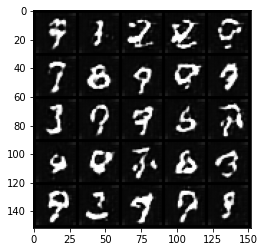

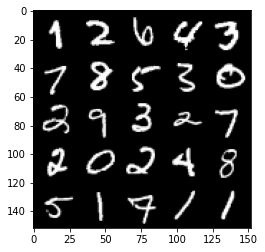

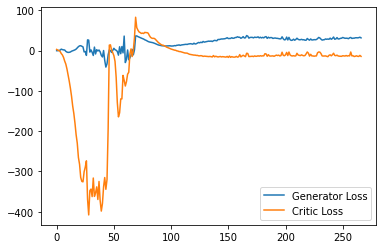

Step 5400: Generator loss: 33.32180503845215, critic loss: -13.180594144821164


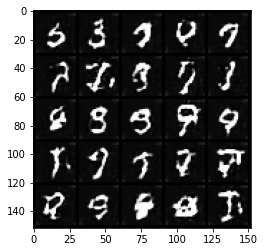

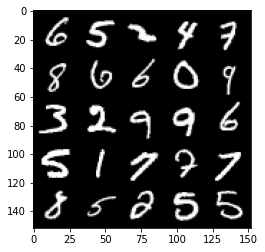

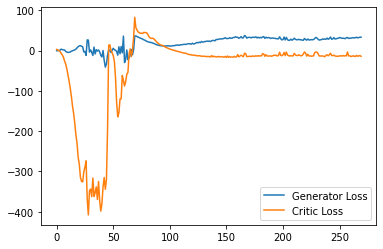

Step 5450: Generator loss: 32.53488300323486, critic loss: -12.996698994636535


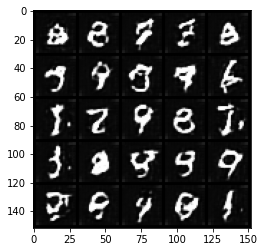

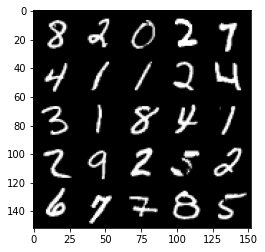

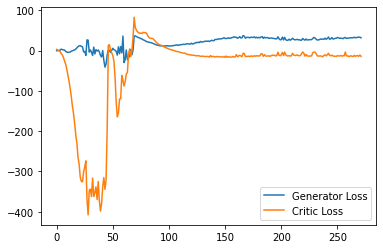

Step 5500: Generator loss: 34.52090053558349, critic loss: -14.053873071670534


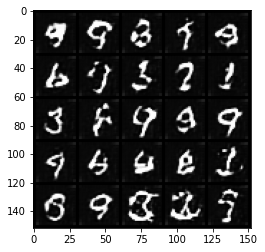

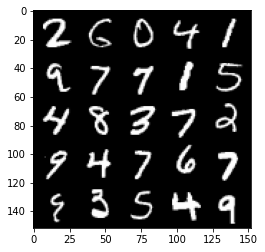

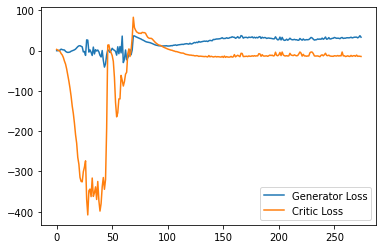

Step 5550: Generator loss: 34.159370803833006, critic loss: -13.425480340003972


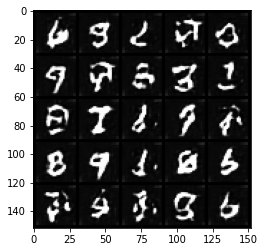

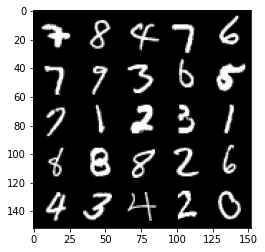

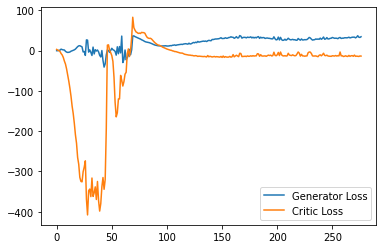

Step 5600: Generator loss: 34.88281726837158, critic loss: -14.72430668258667


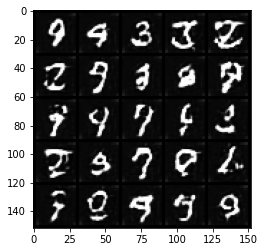

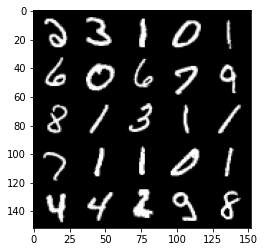

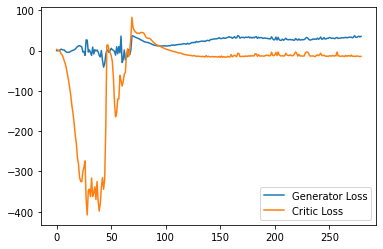

Step 5650: Generator loss: 35.85172378540039, critic loss: -8.780460497856136


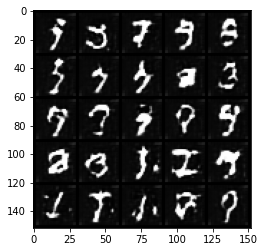

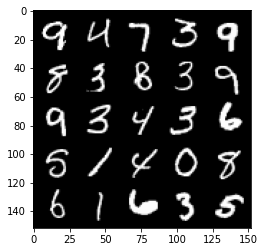

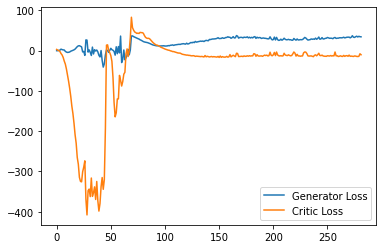

Step 5700: Generator loss: 34.03857921600342, critic loss: -13.364591505050662


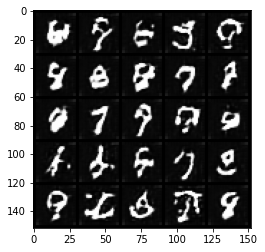

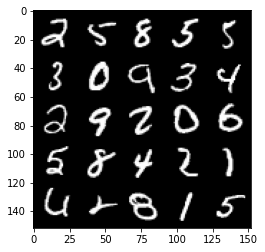

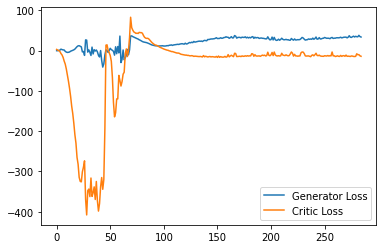

Step 5750: Generator loss: 36.33344814300537, critic loss: -12.171700674057009


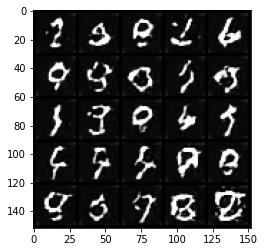

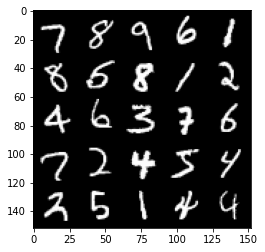

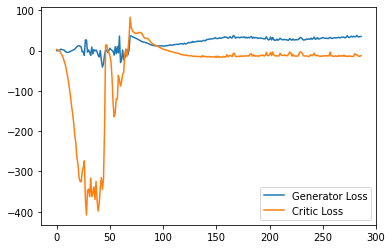

Step 5800: Generator loss: 37.2112911605835, critic loss: -9.279395293235781


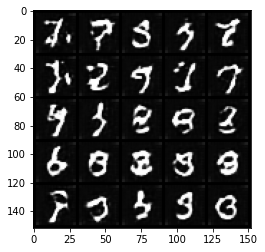

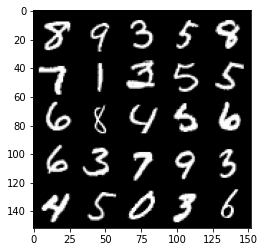

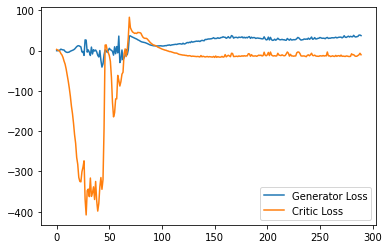

Step 5850: Generator loss: 33.61343757629395, critic loss: -13.944000825881961


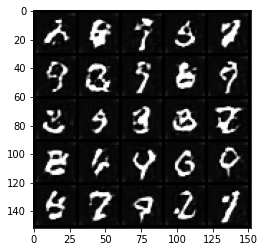

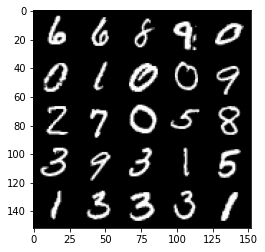

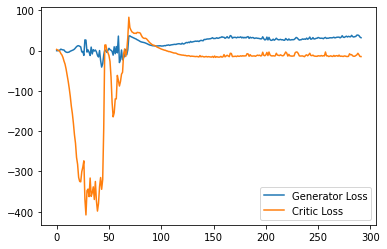

Step 5900: Generator loss: 33.55631889343262, critic loss: -13.97959619092941


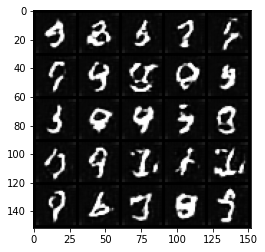

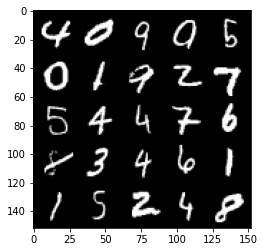

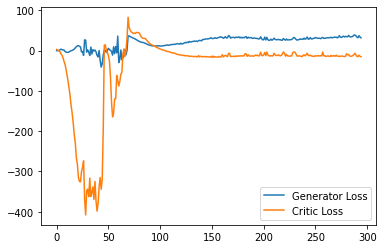

Step 5950: Generator loss: 34.00307826995849, critic loss: -14.071101900577546


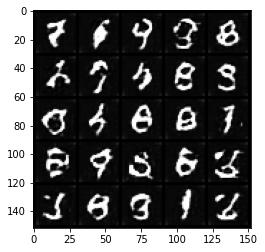

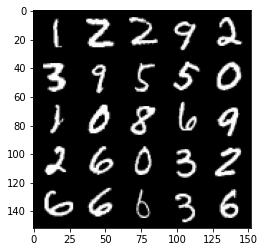

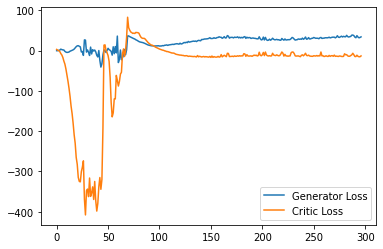

Step 6000: Generator loss: 34.86743999481201, critic loss: -10.380076382637023


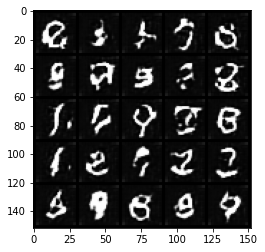

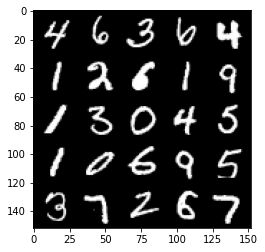

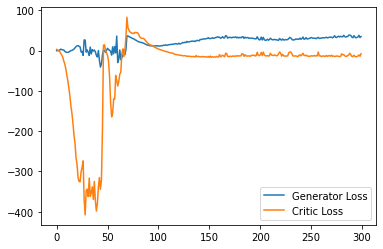

Step 6050: Generator loss: 32.6617151260376, critic loss: -12.675440561294558


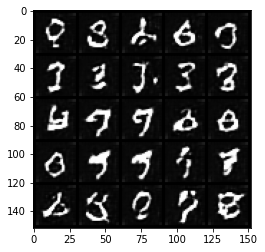

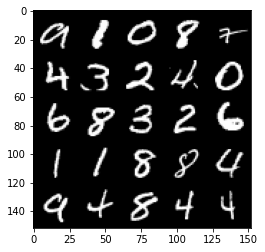

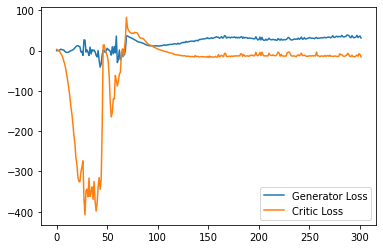

Step 6100: Generator loss: 33.31342803955078, critic loss: -14.447300367355345


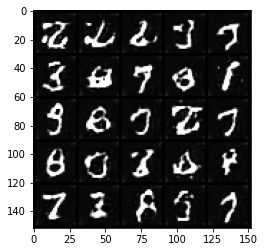

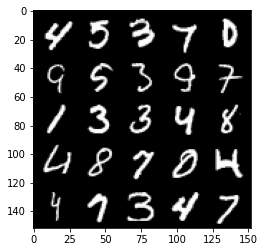

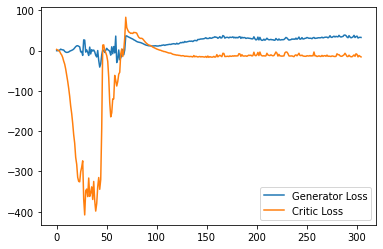

Step 6150: Generator loss: 34.266612396240234, critic loss: -13.006016211509706


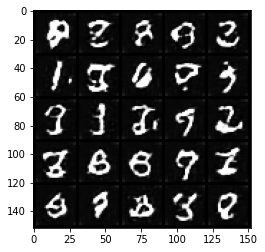

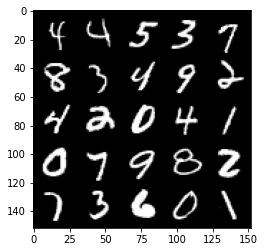

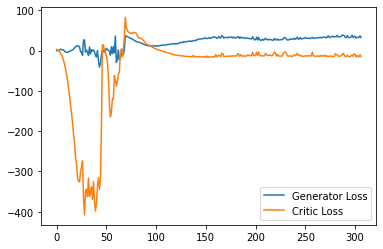

Step 6200: Generator loss: 36.321372184753415, critic loss: -11.837591940402985


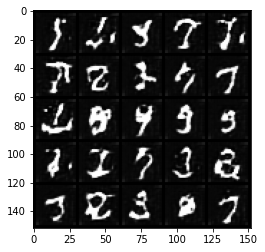

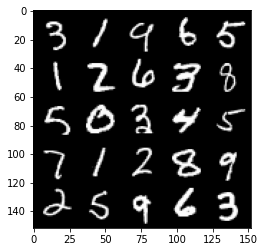

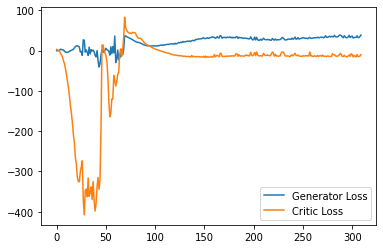

Step 6250: Generator loss: 34.23255340576172, critic loss: -11.934044649124143


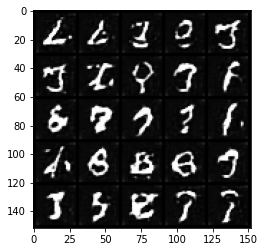

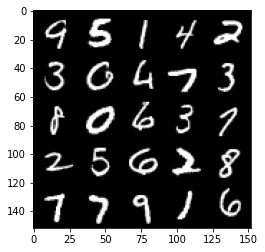

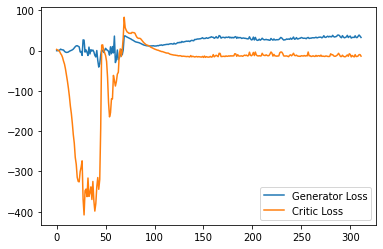

Step 6300: Generator loss: 34.40592994689941, critic loss: -13.746795375823973


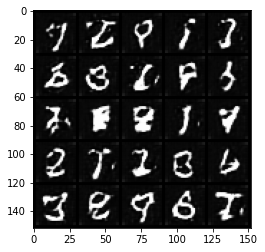

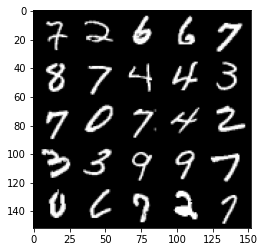

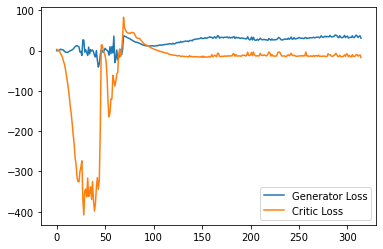

Step 6350: Generator loss: 33.844480209350586, critic loss: -8.308185849189757


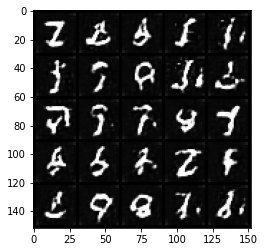

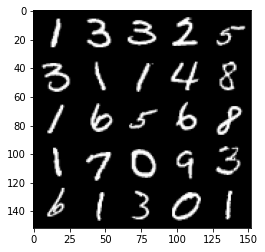

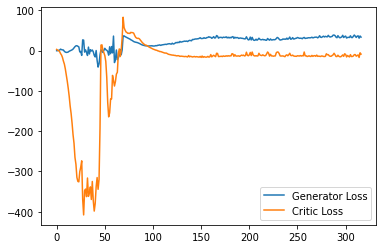

Step 6400: Generator loss: 33.19160541534424, critic loss: -13.522909368515013


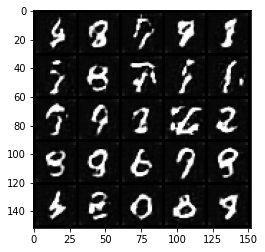

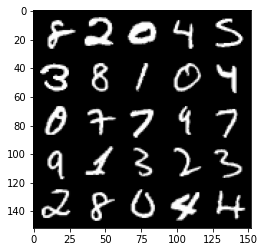

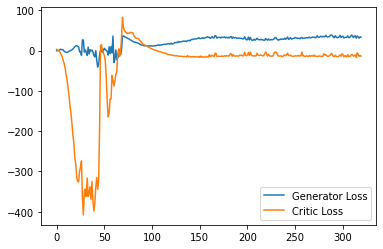

Step 6450: Generator loss: 35.751369094848634, critic loss: -10.071916543006896


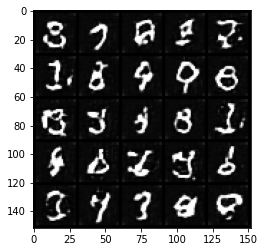

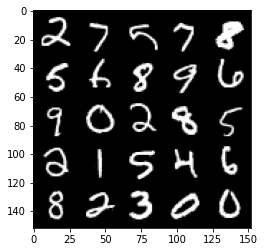

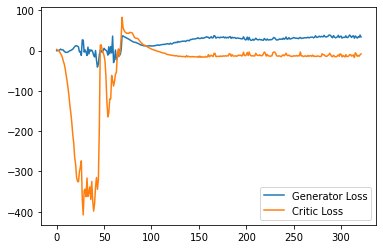

Step 6500: Generator loss: 32.940203475952146, critic loss: -13.353564711093904


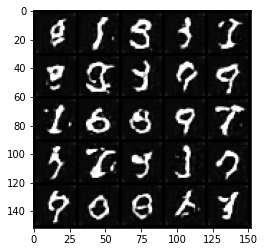

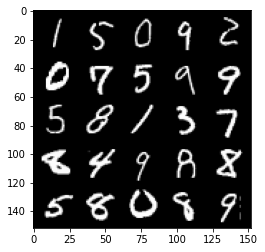

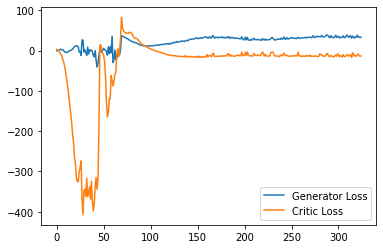

Step 6550: Generator loss: 33.65860565185547, critic loss: -12.804507337093355


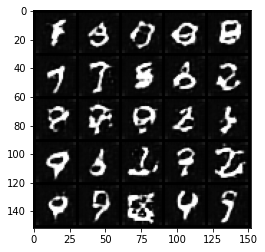

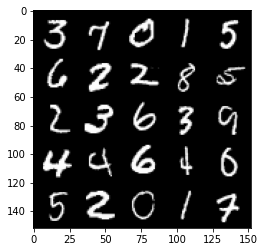

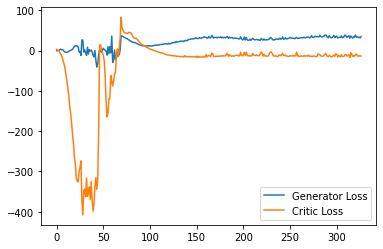

Step 6600: Generator loss: 31.74486961364746, critic loss: -14.43152787923813


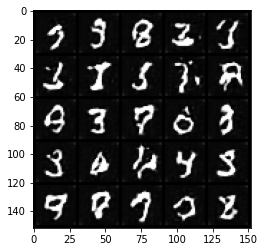

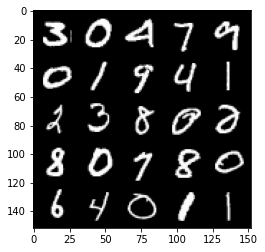

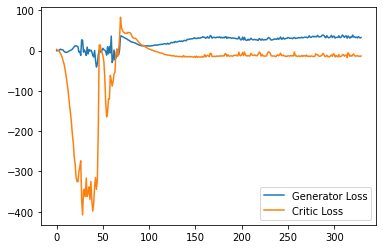

Step 6650: Generator loss: 33.7005927658081, critic loss: -13.98579315567016


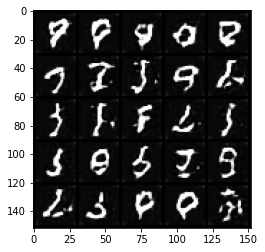

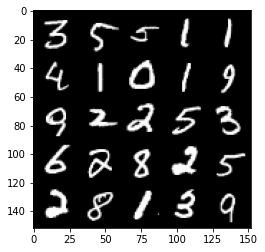

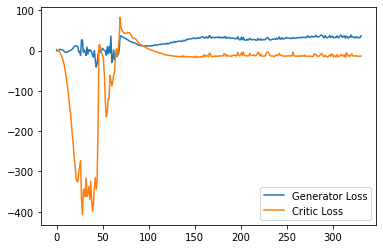

Step 6700: Generator loss: 36.28068260192871, critic loss: -13.068357995510105


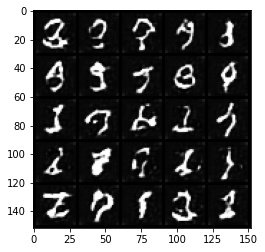

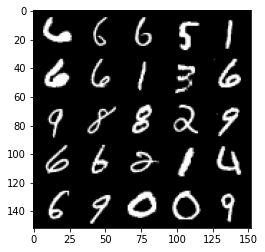

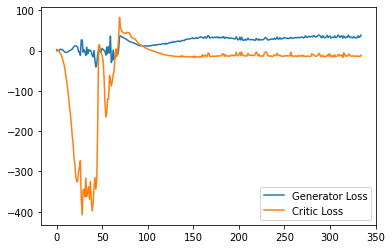

Step 6750: Generator loss: 35.204929237365725, critic loss: -13.400968554496764


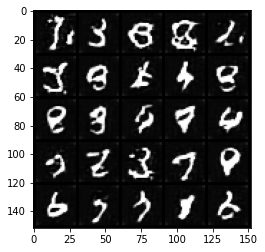

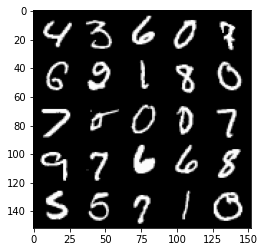

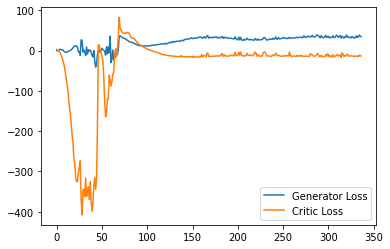

Step 6800: Generator loss: 37.459453430175785, critic loss: -12.201096929073334


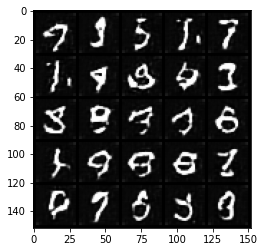

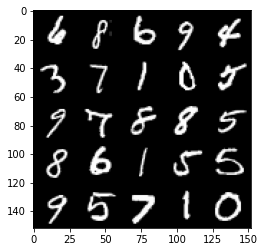

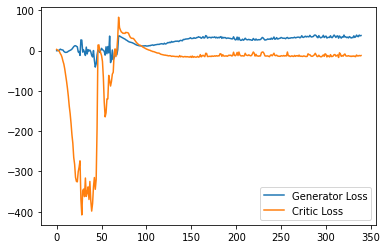

Step 6850: Generator loss: 33.991285133361814, critic loss: -14.837754261970524


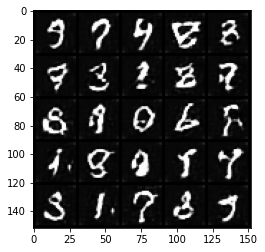

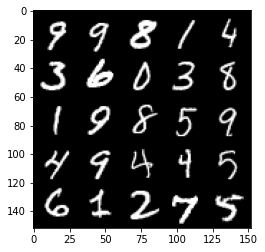

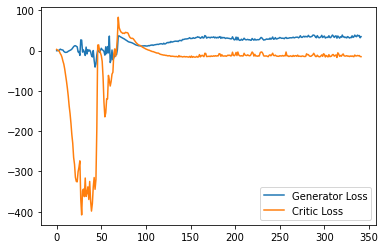

Step 6900: Generator loss: 35.45470119476318, critic loss: -15.129979446411134


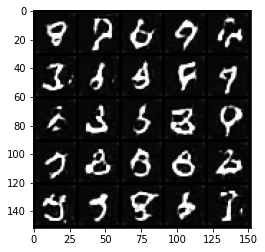

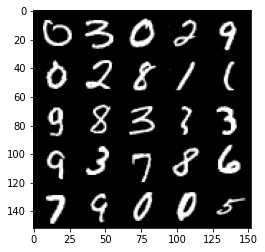

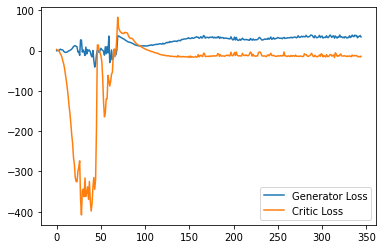

Step 6950: Generator loss: 36.27974220275879, critic loss: -14.482467780113218


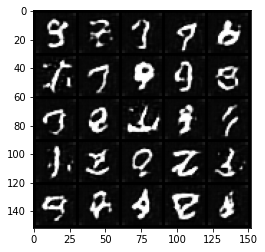

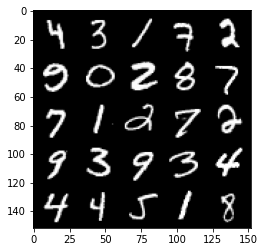

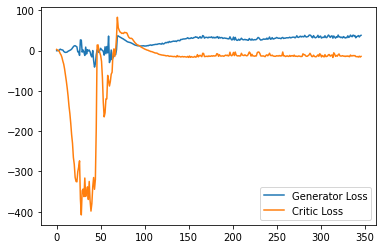

Step 7000: Generator loss: 37.08580413818359, critic loss: -12.952955452919014


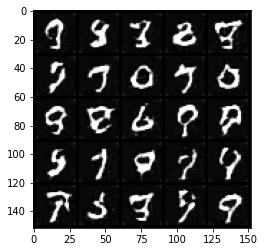

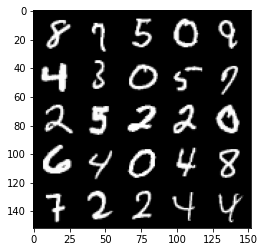

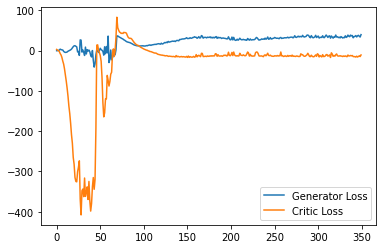

Step 7050: Generator loss: 38.373298530578616, critic loss: -7.903226900100706


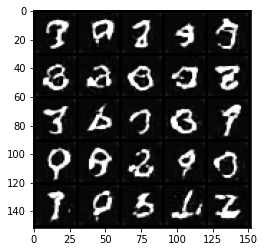

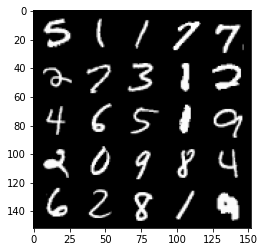

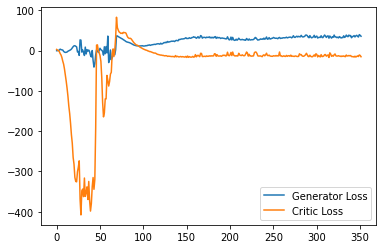

Step 7100: Generator loss: 37.927687606811524, critic loss: -0.6902704424858093


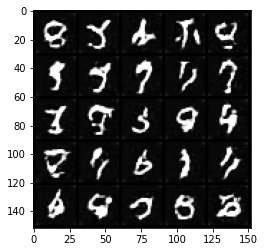

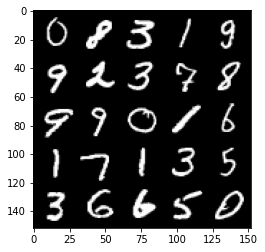

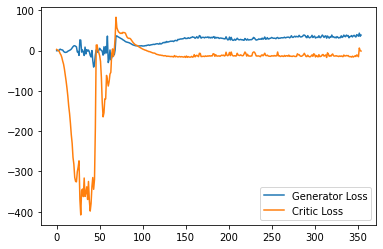

Step 7150: Generator loss: 38.69038673400879, critic loss: -2.0664980959892274


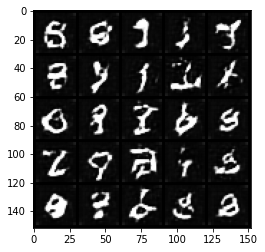

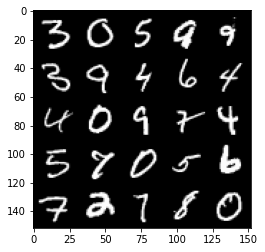

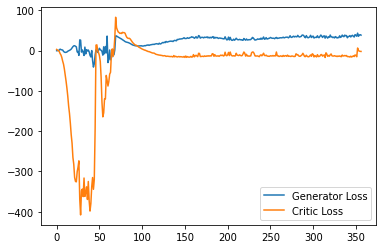

Step 7200: Generator loss: 37.144890213012694, critic loss: -2.6320425682067867


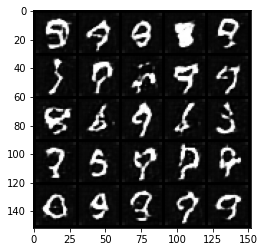

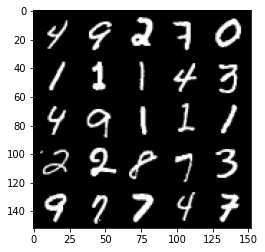

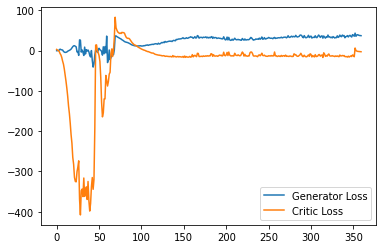

Step 7250: Generator loss: 33.95870044708252, critic loss: -5.362061301231385


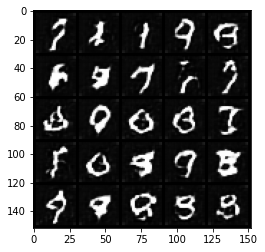

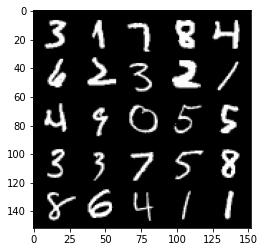

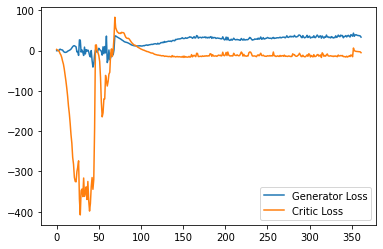

Step 7300: Generator loss: 33.013891525268555, critic loss: -10.119342062473299


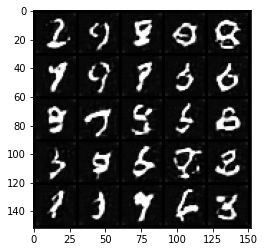

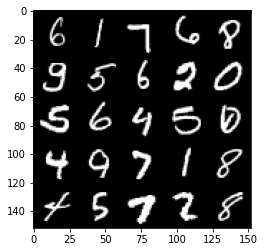

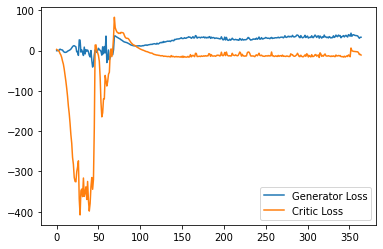

Step 7350: Generator loss: 34.22305969238281, critic loss: -12.05478487110138


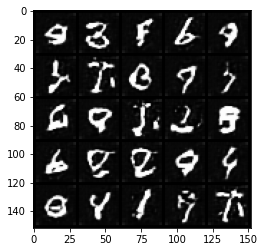

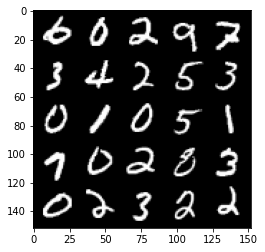

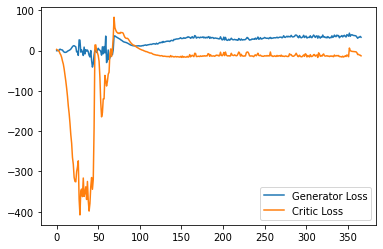

Step 7400: Generator loss: 39.56120231628418, critic loss: -10.547286969184876


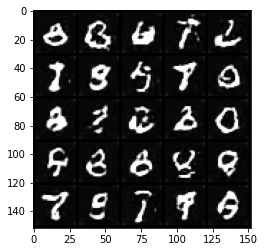

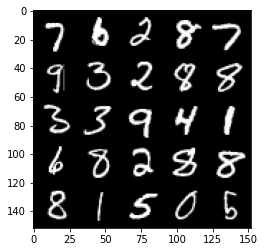

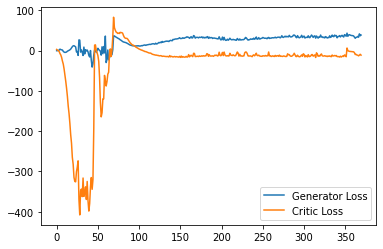

Step 7450: Generator loss: 36.5454500579834, critic loss: -13.589732732772829


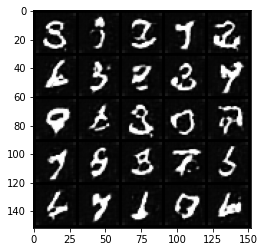

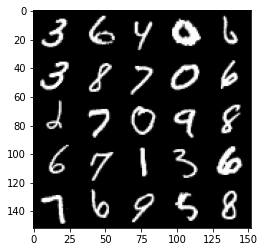

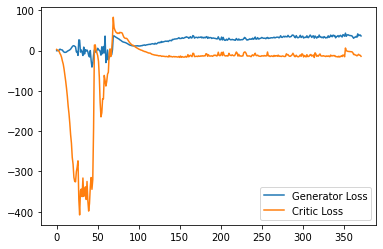

Step 7500: Generator loss: 40.5492985534668, critic loss: -4.369010530471802


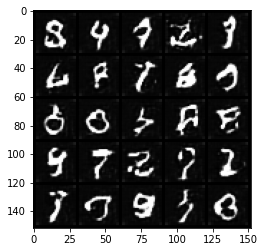

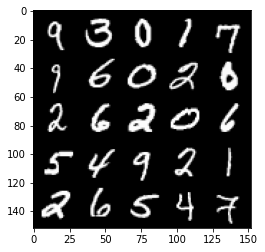

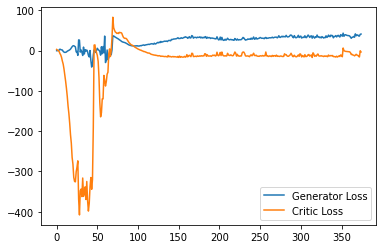

Step 7550: Generator loss: 38.67225395202637, critic loss: -6.902515354394914


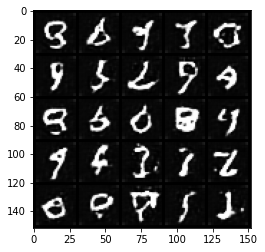

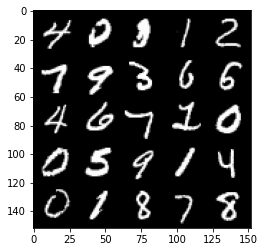

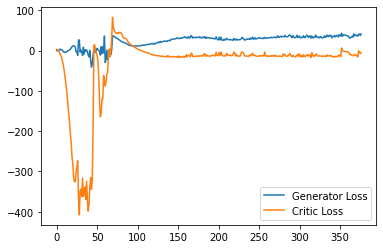

Step 7600: Generator loss: 39.034669723510746, critic loss: -12.170770867824553


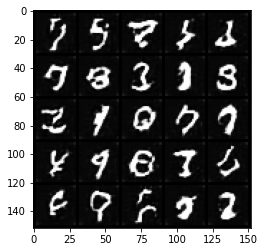

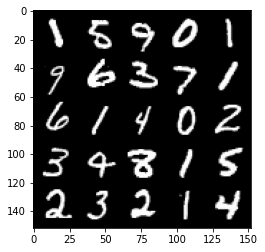

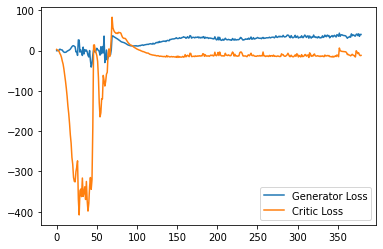

Step 7650: Generator loss: 37.611569519042966, critic loss: -13.343146010875705


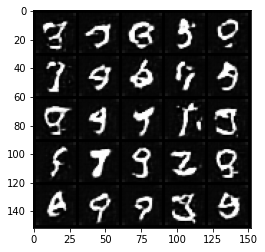

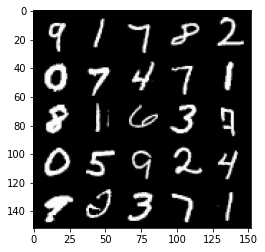

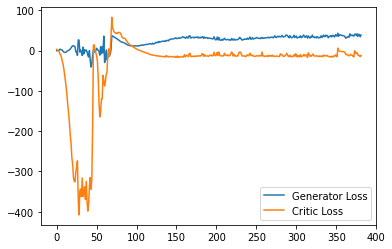

Step 7700: Generator loss: 38.159222526550295, critic loss: -14.29494747018814


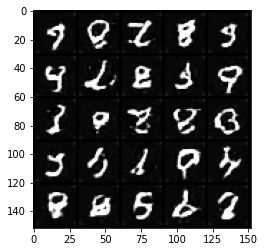

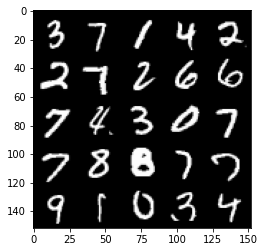

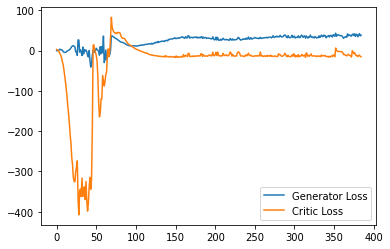

Step 7750: Generator loss: 41.271960487365725, critic loss: -10.592385048389438


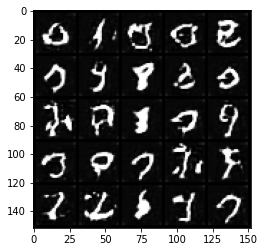

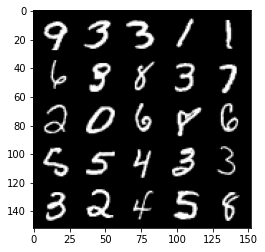

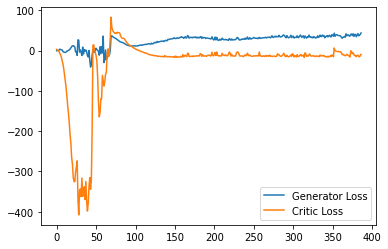

Step 7800: Generator loss: 36.0077445602417, critic loss: -14.657789519786837


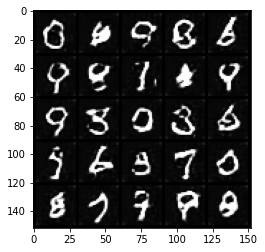

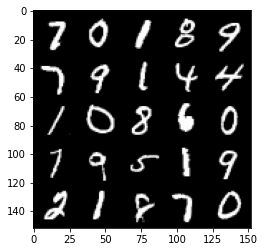

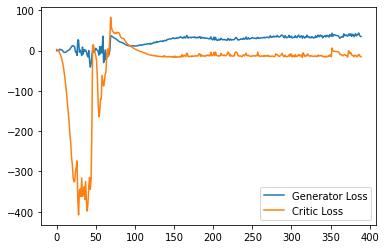

Step 7850: Generator loss: 40.1744507598877, critic loss: -12.201912966251372


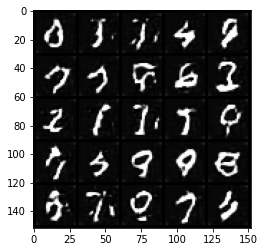

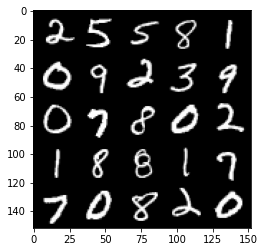

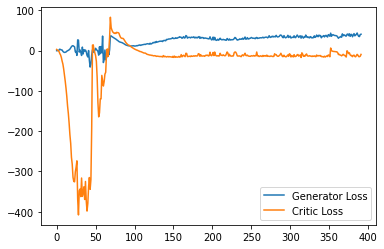

Step 7900: Generator loss: 40.67720684051514, critic loss: -13.2080921087265


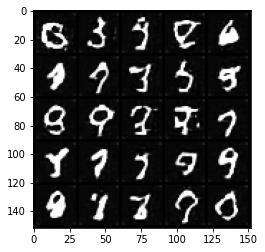

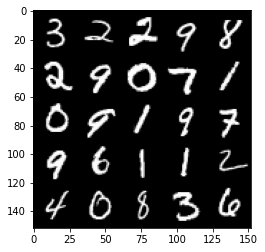

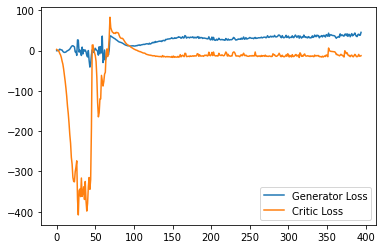

Step 7950: Generator loss: 39.937404518127444, critic loss: -14.02653639125824


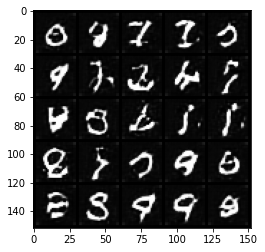

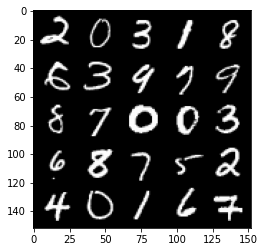

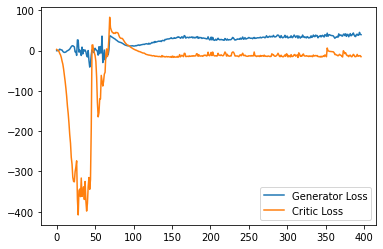

Step 8000: Generator loss: 41.36644618988037, critic loss: -13.59320766067505


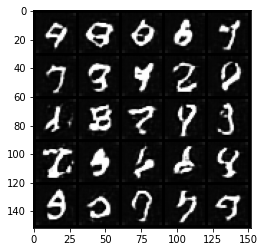

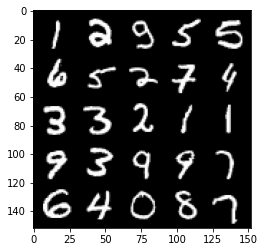

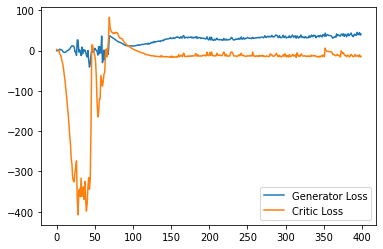

Step 8050: Generator loss: 41.98312103271484, critic loss: -14.3136579155922


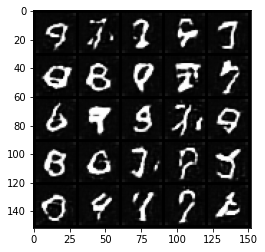

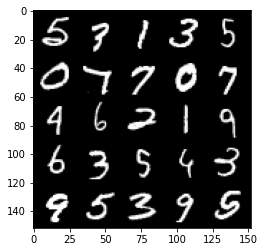

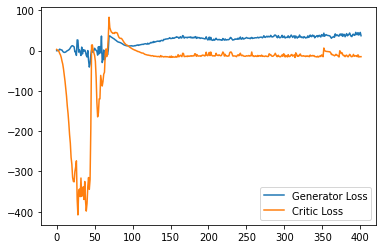

Step 8100: Generator loss: 41.2214278793335, critic loss: -14.951277585506443


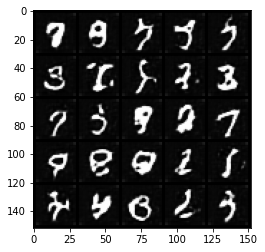

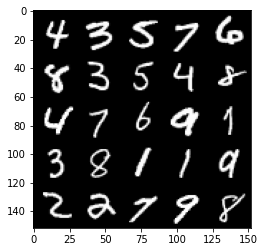

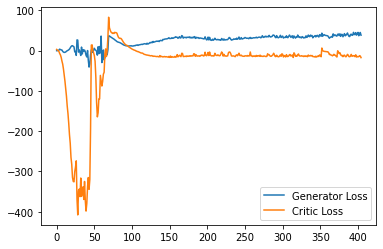

Step 8150: Generator loss: 48.14369987487793, critic loss: 0.9029869880676283


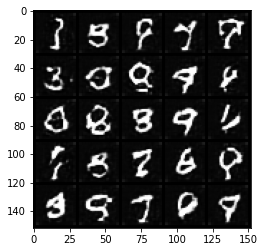

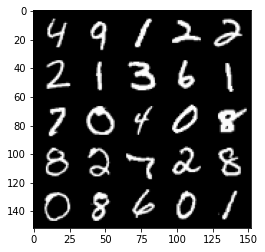

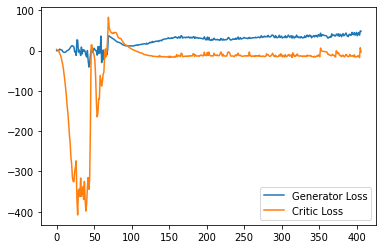

Step 8200: Generator loss: 43.28471160888672, critic loss: -8.979180919885634


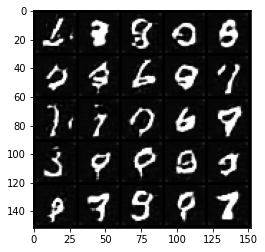

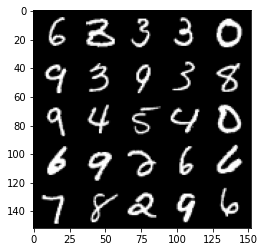

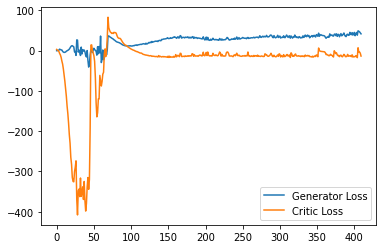

Step 8250: Generator loss: 42.710310821533206, critic loss: -14.935203665256504


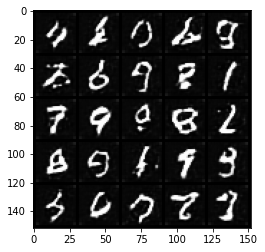

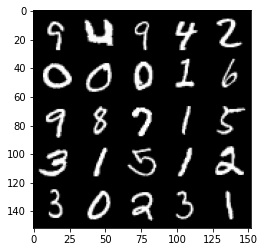

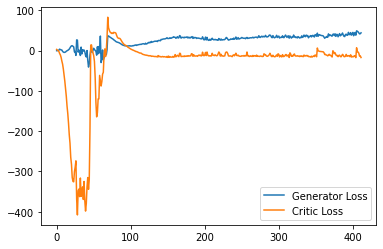

Step 8300: Generator loss: 44.23631874084472, critic loss: -13.091110986232758


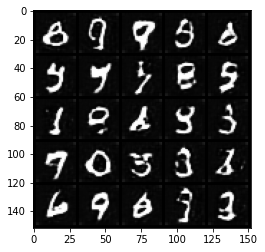

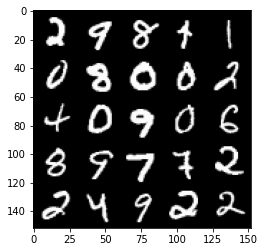

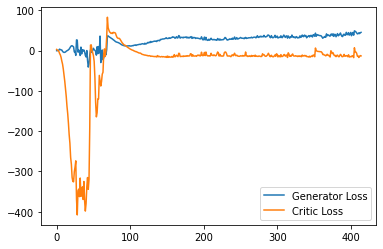

Step 8350: Generator loss: 46.17432563781738, critic loss: -13.734895227909089


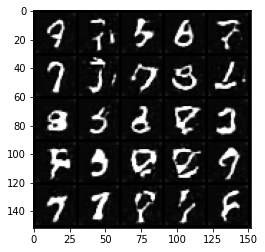

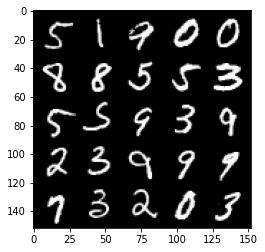

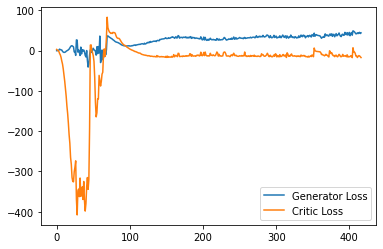

Step 8400: Generator loss: 43.96708351135254, critic loss: -12.447994434833529


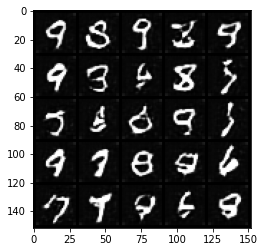

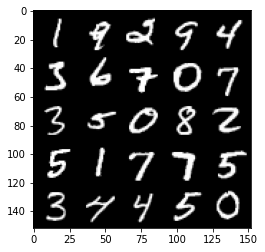

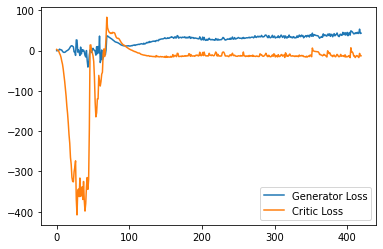

Step 8450: Generator loss: 43.42603889465332, critic loss: -14.811978808879854


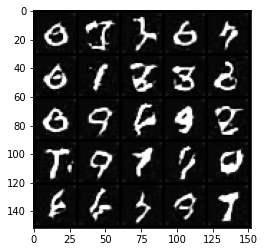

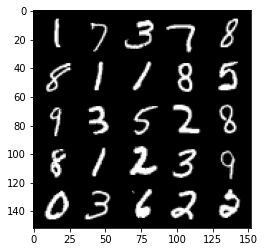

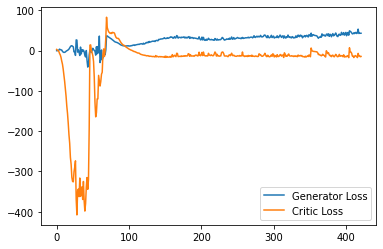

Step 8500: Generator loss: 43.79879737854004, critic loss: -15.490615593433374


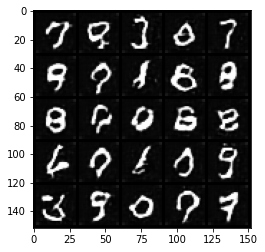

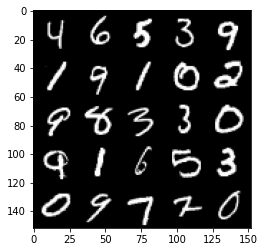

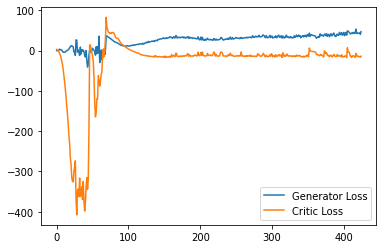

Step 8550: Generator loss: 47.807112045288086, critic loss: -11.749972937107087


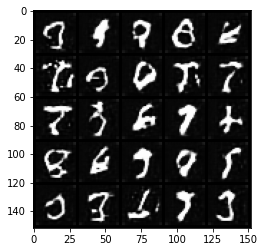

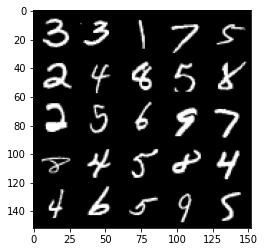

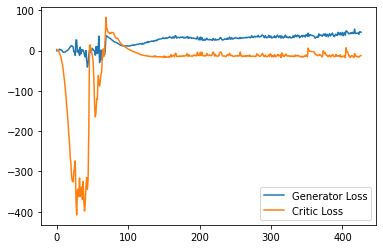

Step 8600: Generator loss: 45.070284576416014, critic loss: -13.856874792575836


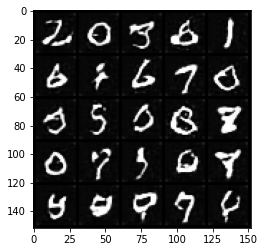

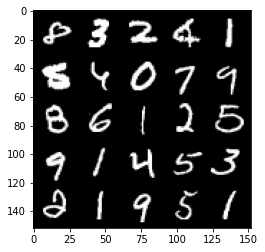

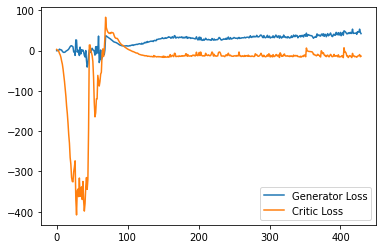

Step 8650: Generator loss: 46.951292190551754, critic loss: -11.82236302947998


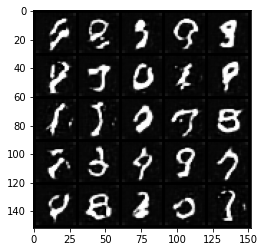

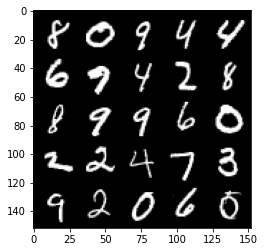

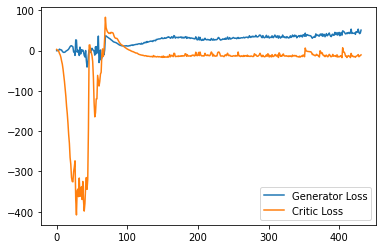

Step 8700: Generator loss: 44.80994644165039, critic loss: -15.80258806180954


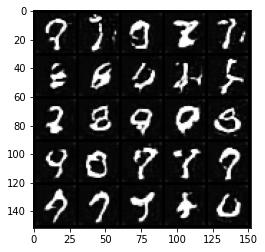

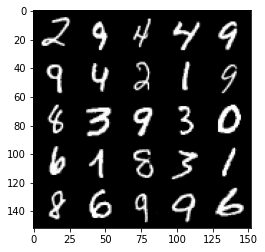

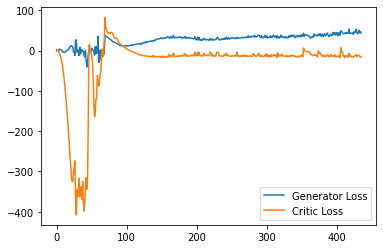

Step 8750: Generator loss: 44.7275288772583, critic loss: -15.023035004615778


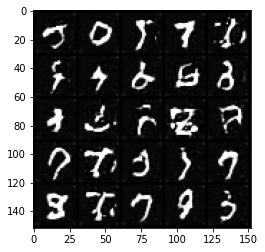

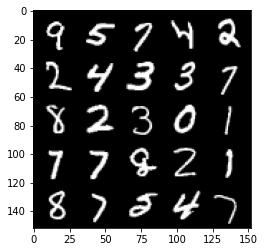

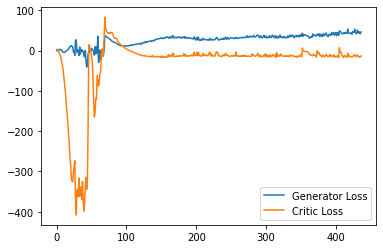

Step 8800: Generator loss: 45.67846580505371, critic loss: -14.70692400026321


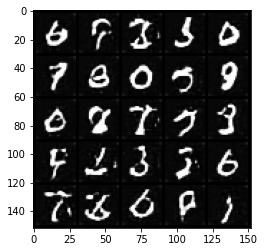

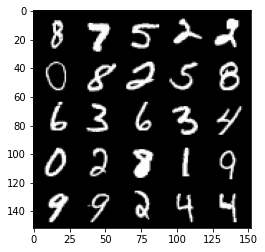

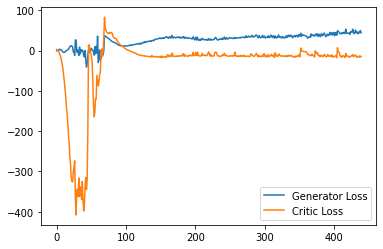

Step 8850: Generator loss: 46.53231979370117, critic loss: -11.979565131187437


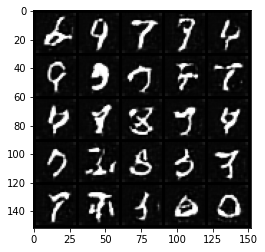

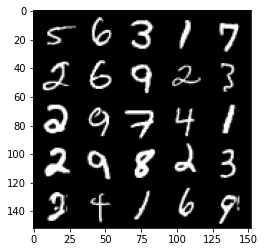

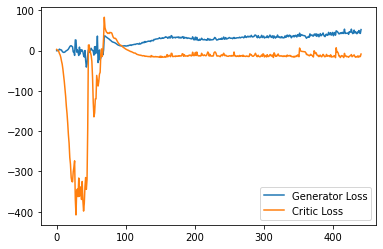

Step 8900: Generator loss: 45.85737838745117, critic loss: -13.29920951461792


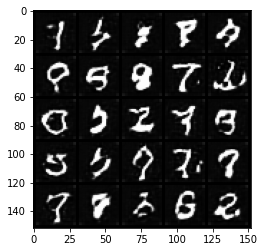

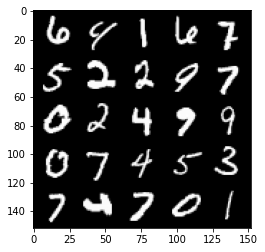

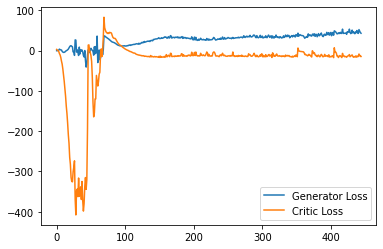

Step 8950: Generator loss: 46.59550346374512, critic loss: -12.700007756710058


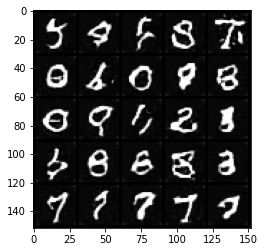

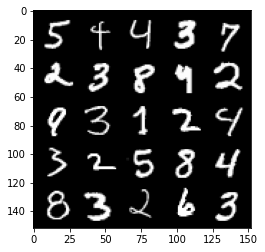

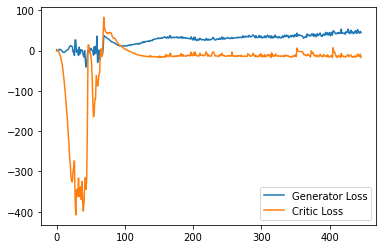

Step 9000: Generator loss: 43.46124290466309, critic loss: -14.32714592242241


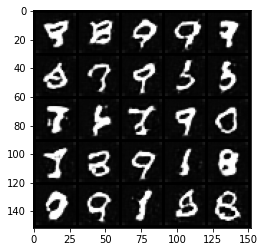

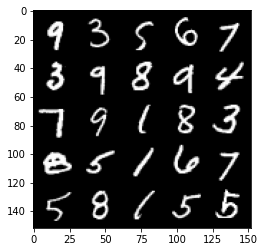

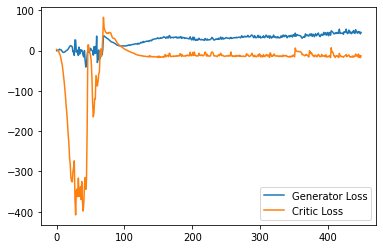

Step 9050: Generator loss: 47.9188500213623, critic loss: -11.212228137016298


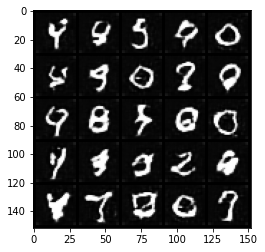

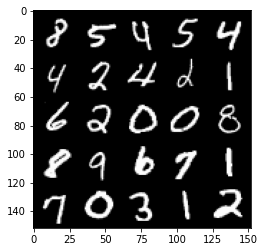

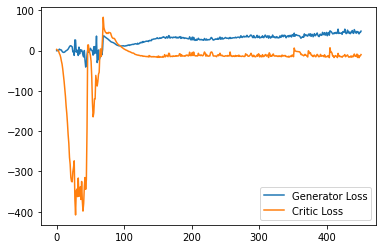

Step 9100: Generator loss: 45.15119247436523, critic loss: -15.035167333126067


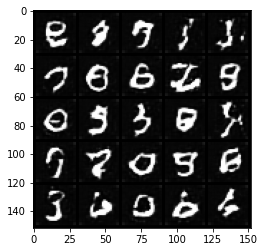

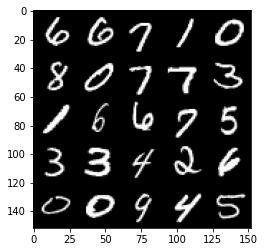

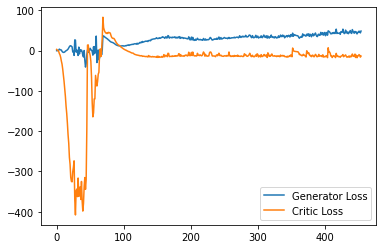

Step 9150: Generator loss: 44.235171966552734, critic loss: -12.52390331721306


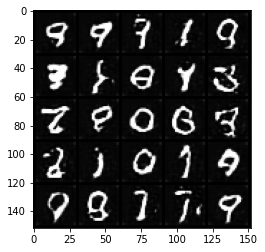

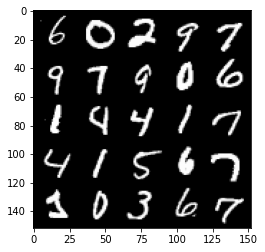

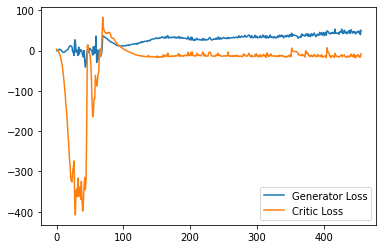

Step 9200: Generator loss: 43.0066635131836, critic loss: -14.583791330814366


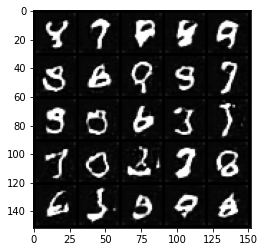

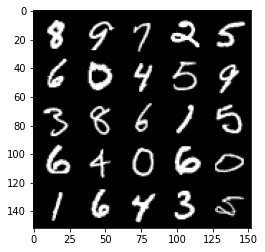

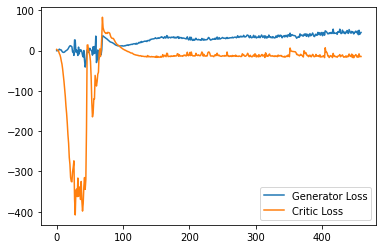

Step 9250: Generator loss: 44.42987789154053, critic loss: -14.326948598861692


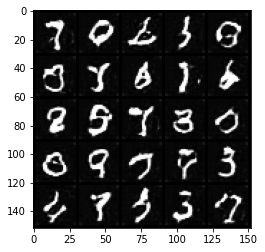

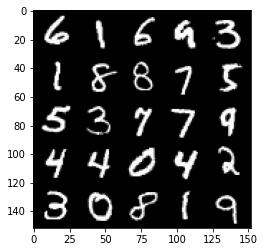

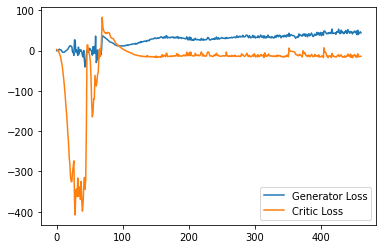

Step 9300: Generator loss: 42.151025733947755, critic loss: -17.93863091278076


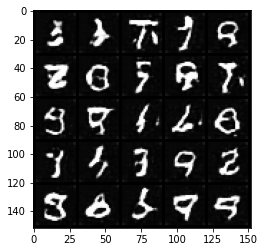

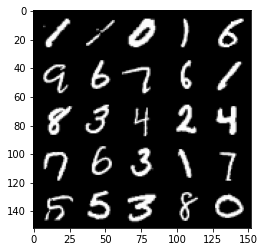

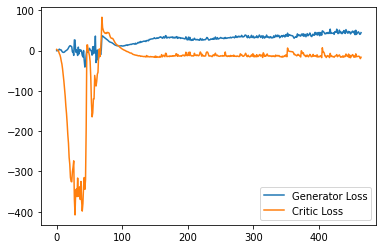

Step 9350: Generator loss: 46.690338897705075, critic loss: -5.957453840255738


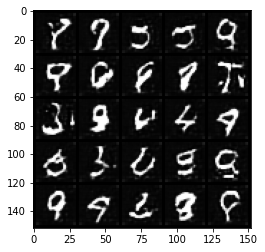

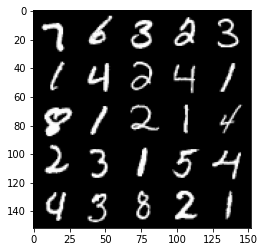

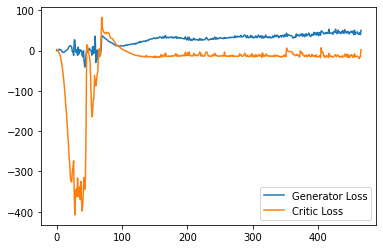

Step 9400: Generator loss: 42.261271438598634, critic loss: -14.110033886432648


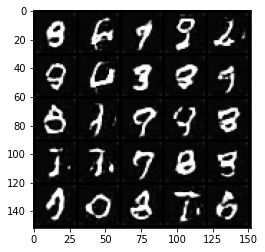

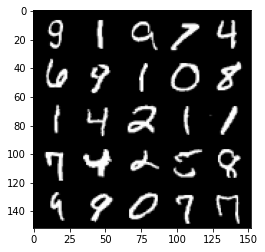

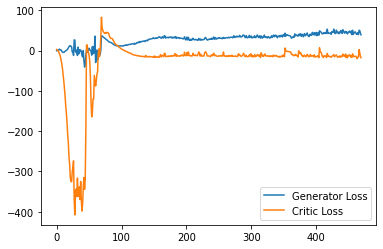

Step 9450: Generator loss: 44.2331681060791, critic loss: -15.086699719429015


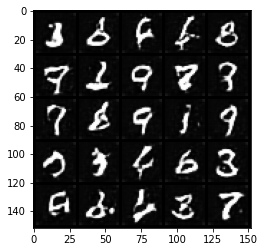

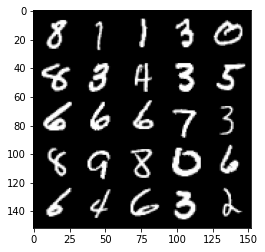

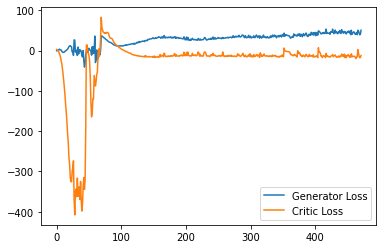

Step 9500: Generator loss: 46.45863079071045, critic loss: -15.296858103752138


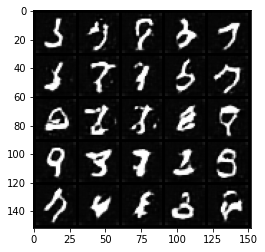

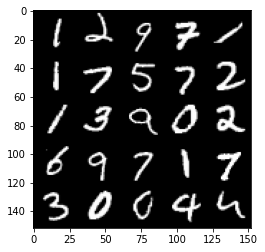

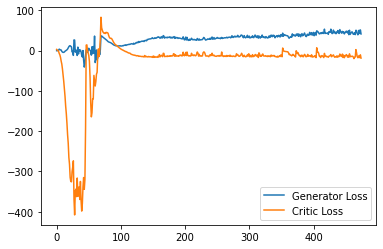

Step 9550: Generator loss: 45.59411666870117, critic loss: -14.979706670761107


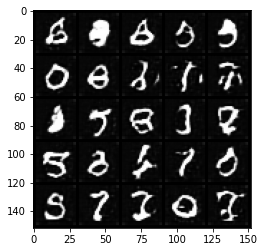

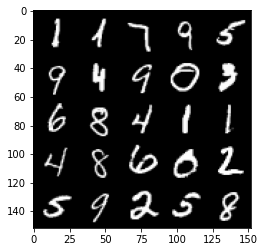

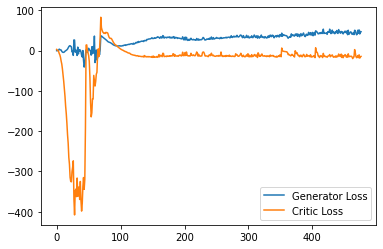

Step 9600: Generator loss: 47.14773239135742, critic loss: -15.083294231414795


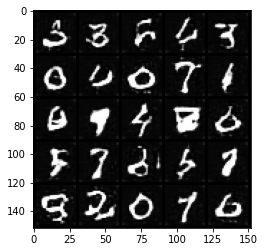

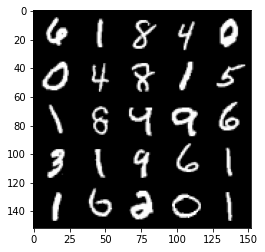

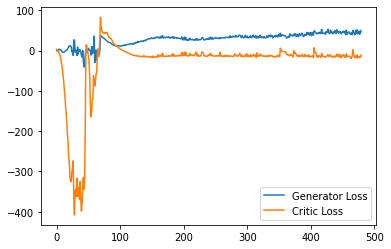

Step 9650: Generator loss: 44.32528308868408, critic loss: -12.831254226446154


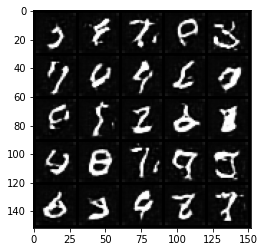

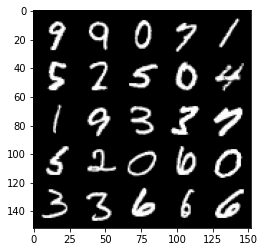

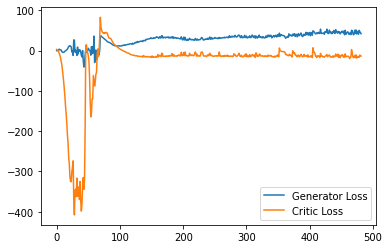

Step 9700: Generator loss: 43.04048564910889, critic loss: -14.643267675876613


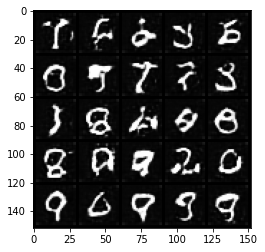

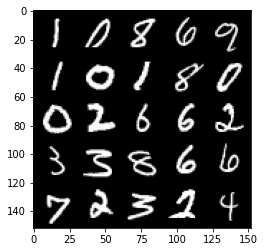

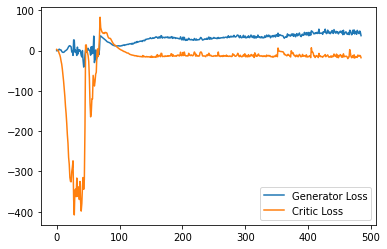

Step 9750: Generator loss: 42.76725036621094, critic loss: -10.257062614917754


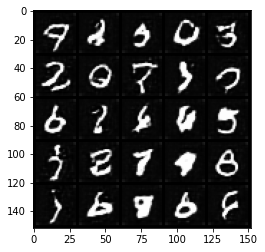

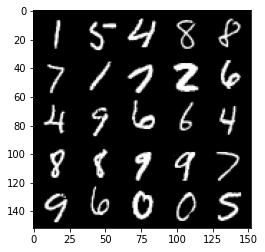

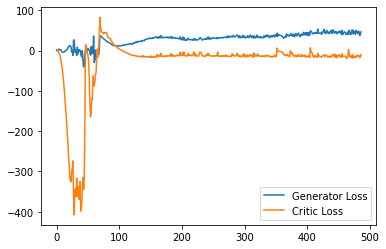

Step 9800: Generator loss: 39.292025871276856, critic loss: -15.737060754776007


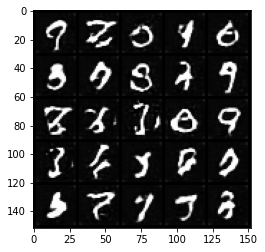

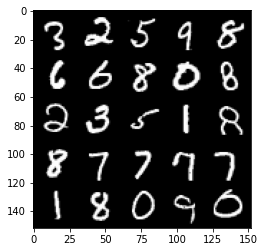

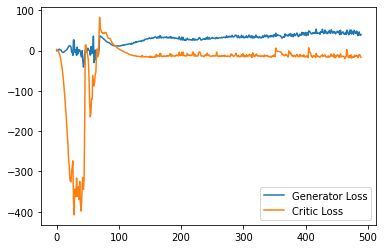

Step 9850: Generator loss: 41.67051544189453, critic loss: -15.03344743490219


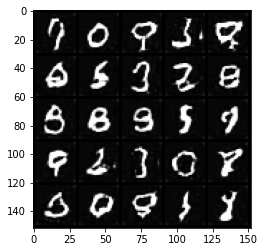

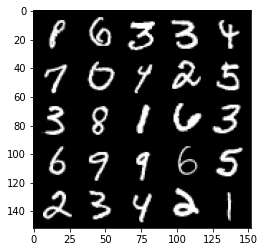

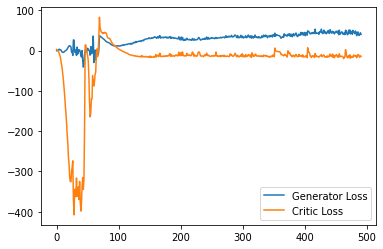

Step 9900: Generator loss: 42.58747123718262, critic loss: -15.427520470619202


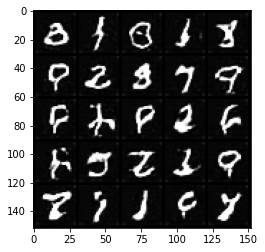

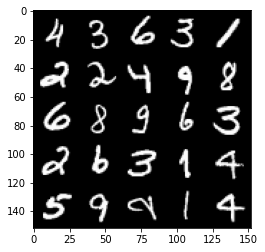

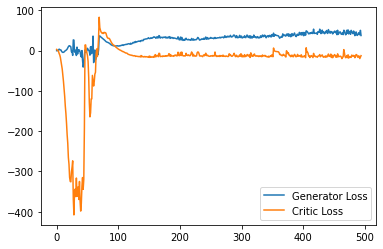

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1


In [ ]:
!pip freeze